### Velocity demo
Current approach shares full optimizer state between rounds. Optimizer states are aggregated when received on server end and then shared out such that all clients begin the next round with the aggregated optimizer state.
Limitations: 
- We are not measuring communication from this, but if desired, it should be pretty easy to add
- Currently, we share the entire optimizer state, but when training only a single layer, we would only need to share the state related to that layer. To only share updated layer, modify _aggregate_optimizer_states.

In [2]:
from collections import OrderedDict
from typing import Dict, List, Optional, Tuple, Union, Callable


import matplotlib.pyplot as plt
import numpy as np
import torch
import torch.nn as nn
import copy
import sys
import base64
import pickle
import copy
import torch.nn.functional as F
import torchvision.transforms as transforms
from datasets.utils.logging import disable_progress_bar
from torch.utils.data import DataLoader
from flwr.server.strategy import Strategy
import flwr
from flwr.client import Client, ClientApp, NumPyClient
from flwr.common import Metrics, Context, Status, GetParametersRes, Parameters, GetParametersIns, MetricsAggregationFn,NDArrays,Scalar
from flwr.server import ServerApp, ServerConfig, ServerAppComponents 
from flwr.server.strategy import FedAvg, FedProx
from flwr.simulation import run_simulation
from flwr_datasets import FederatedDataset
from flwr.common import (
    EvaluateIns,
    EvaluateRes,
    FitIns,
    FitRes,
    Parameters,
    Scalar,
    ndarrays_to_parameters,
    ParametersRecord,
    parameters_to_ndarrays,
    array_from_numpy
)
from flwr.server.client_manager import ClientManager
from flwr.server.client_proxy import ClientProxy
from flwr.server.strategy.aggregate import aggregate, weighted_loss_avg

DEVICE = "cuda" if torch.cuda.is_available() else "cpu"
DEVICE = "mps"
print(f"Training on {DEVICE}")
print(f"Flower {flwr.__version__} / PyTorch {torch.__version__}")
disable_progress_bar()

Training on mps
Flower 1.15.1 / PyTorch 2.6.0


In [3]:

BATCH_SIZE = 32

def load_datasets(partition_id, num_partitions: int):
    fds = FederatedDataset(dataset="cifar10", partitioners={"train": num_partitions})
    partition = fds.load_partition(partition_id)
    # Divide data on each node: 80% train, 20% test
    partition_train_test = partition.train_test_split(test_size=0.2, seed=42)
    pytorch_transforms = transforms.Compose(
        [transforms.ToTensor(), transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5))]
    )

    def apply_transforms(batch):
        
        batch["img"] = [pytorch_transforms(img) for img in batch["img"]]
        return batch

    partition_train_test = partition_train_test.with_transform(apply_transforms)
    trainloader = DataLoader(partition_train_test["train"], batch_size=32, shuffle=True)
    valloader = DataLoader(partition_train_test["test"], batch_size=32)
    testset = fds.load_split("test").with_transform(apply_transforms)
    testloader = DataLoader(testset, batch_size=32)
    return trainloader, valloader, testloader

In [4]:
class Net(nn.Module):
    def __init__(self) -> None:
        super(Net, self).__init__()
        self.conv1 = nn.Conv2d(3, 6, 5)
        self.pool = nn.MaxPool2d(2, 2)
        self.conv2 = nn.Conv2d(6, 16, 5)
        self.fc1 = nn.Linear(16 * 5 * 5, 180)
        self.fc2 = nn.Linear(180, 160)
        self.fc3 = nn.Linear(160, 140)
        self.fc4 = nn.Linear(140, 120)
        self.fc5 = nn.Linear(120, 84)
        # self.fc6 = nn.Linear(100, 84)
        self.fc7 = nn.Linear(84, 10)

    def forward(self, x: torch.Tensor) -> torch.Tensor:
        x = self.pool(F.relu(self.conv1(x)))
        x = self.pool(F.relu(self.conv2(x)))
        x = x.view(-1, 16 * 5 * 5)
        x = F.relu(self.fc1(x))
        x = F.relu(self.fc2(x))
        x = F.relu(self.fc3(x))
        x = F.relu(self.fc4(x))
        x = F.relu(self.fc5(x))
        # x = F.relu(self.fc6(x))
        x = self.fc7(x)
        return x


# class Net(nn.Module):
#     def __init__(self) -> None:
#         super(Net, self).__init__()
#         self.conv1 = nn.Conv2d(3, 32, kernel_size=3, padding=1)
#         self.conv2 = nn.Conv2d(32, 64, kernel_size=3, stride=1, padding=1)
#         self.pool1 = nn.MaxPool2d(2, 2)
#         self.conv3 = nn.Conv2d(64, 128, kernel_size=3, stride=1, padding=1)
#         self.conv4 = nn.Conv2d(128, 128, kernel_size=3, stride=1, padding=1)
#         self.pool2 = nn.MaxPool2d(2, 2)
#         self.conv5 = nn.Conv2d(128, 256, kernel_size=3, stride=1, padding=1)
#         self.conv6 = nn.Conv2d(256, 256, kernel_size=3, stride=1, padding=1)
#         self.pool3 = nn.MaxPool2d(2, 2)
#         self.fc1 = nn.Linear(256*4*4, 1024)
#         self.fc2 = nn.Linear(1024, 512)
#         self.fc3 = nn.Linear(512, 10)
        
#     def forward(self, x: torch.Tensor) -> torch.Tensor:
#         x = F.relu(self.conv1(x))
#         x = F.relu(self.conv2(x))
#         x = self.pool1(x)
#         x = F.relu(self.conv3(x))
#         x = F.relu(self.conv4(x))
#         x = self.pool2(x)
#         x = F.relu(self.conv5(x))
#         x = F.relu(self.conv6(x))
#         x = self.pool3(x)
#         x = x.view(-1, 256*4*4)
#         x = F.relu(self.fc1(x))
#         x = F.relu(self.fc2(x))
#         x = self.fc3(x)
#         return x


def get_parameters(net) -> List[np.ndarray]:
    return [val.cpu().numpy() for _, val in net.state_dict().items()]


def set_parameters(net, parameters, trainable_layers=-1):
    """Set model parameters from a list of NumPy arrays."""
    current_state = OrderedDict(net.state_dict())
    
    if trainable_layers == -1:
        # Update all parameters
        params_dict = zip(current_state.keys(), parameters)
        state_dict = OrderedDict({k: torch.Tensor(v) for k, v in params_dict})
        net.load_state_dict(state_dict, strict=True)
    else:
        # Only update the specified layer's parameters
        # Convert current state to numpy arrays
        numpy_state = [param.cpu().numpy() for param in current_state.values()]
        
        # Update the specific indices with new parameters
        numpy_state[trainable_layers*2] = parameters[0]
        numpy_state[trainable_layers*2 + 1] = parameters[1]
        
        # Convert back to torch and update state dict
        for idx, key in enumerate(current_state.keys()):
            current_state[key] = torch.from_numpy(numpy_state[idx])
        
        net.load_state_dict(current_state, strict=True)


def train(net, trainloader, epochs: int, optimizer=None):
    """Train the network on the training set."""
    print(f"training network...")
    criterion = torch.nn.CrossEntropyLoss()
    if optimizer is None:
        optimizer = torch.optim.Adam(net.parameters())
    net.train()
    for epoch in range(epochs):
        correct, total, epoch_loss = 0, 0, 0.0
        for batch in trainloader:
            images, labels = batch["img"], batch["label"]
            images, labels = images.to(DEVICE), labels.to(DEVICE)
            optimizer.zero_grad()
            outputs = net(images)
            loss = criterion(net(images), labels)
            loss.backward()
            optimizer.step()
            # Metrics
            epoch_loss += loss
            total += labels.size(0)
            correct += (torch.max(outputs.data, 1)[1] == labels).sum().item()
        epoch_loss /= len(trainloader.dataset)
        epoch_acc = correct / total
        print(f"Epoch {epoch+1}: train loss {epoch_loss}, accuracy {epoch_acc}")


def test(net, testloader):
    """Evaluate the network on the entire test set."""
    criterion = torch.nn.CrossEntropyLoss()
    correct, total, loss = 0, 0, 0.0
    net.eval()
    with torch.no_grad():
        for batch in testloader:
            images, labels = batch["img"], batch["label"]
            images, labels = images.to(DEVICE), labels.to(DEVICE)
            outputs = net(images)
            loss += criterion(outputs, labels).item()
            _, predicted = torch.max(outputs.data, 1)
            total += labels.size(0)
            correct += (predicted == labels).sum().item()
    loss /= len(testloader.dataset)
    accuracy = correct / total
    return loss, accuracy

def freeze_layers(model: torch.nn.Module, trainable_layers: int) -> None:
        """Freeze specified layers of the model."""
        trainable_layers_set = []
        if trainable_layers == -1:
            trainable_layers_set = [-1]
        else:
            trainable_layers_set = [trainable_layers *2, trainable_layers *2 +1]

        for idx, (name, param) in enumerate(model.named_parameters()):
            
            if idx in trainable_layers_set or trainable_layers_set[0] == -1:
                param.requires_grad = True
                print(f"layer index is {idx} and name{name} is trainabe")
            else:
                param.requires_grad = False
                print(f"layer index is {idx} and name{name} is frozen")


def get_parameters_size(params: Parameters) -> int:
    size = sys.getsizeof(params)  # Base size of the dataclass instance
    size += sys.getsizeof(params.tensor_type)  # Size of the string
    size += sys.getsizeof(params.tensors)  # Size of the list container
    size += sum(sys.getsizeof(tensor) for tensor in params.tensors)  # Size of each bytes object
    return size

def serialize_optimizer_state(state_dict):
    """Serialize optimizer state with reduced memory footprint"""
    lightweight_state = {'state': {}, 'param_groups': state_dict['param_groups']}
    
    for k, v in state_dict['state'].items():
        lightweight_state['state'][k] = {
            'exp_avg': v['exp_avg'].clone().detach().cpu().half().numpy(),  # Use half precision
            'exp_avg_sq': v['exp_avg_sq'].clone().detach().cpu().half().numpy(),
            'step': v['step'].item()  # Store as scalar instead of tensor
        }
    
    return base64.b64encode(pickle.dumps(lightweight_state, protocol=pickle.HIGHEST_PROTOCOL)).decode('ascii')

def deserialize_optimizer_state(serialized_state):
    """Deserialize and reconstruct optimizer state"""
    state_dict = pickle.loads(base64.b64decode(serialized_state))
    reconstructed_state = {'state': {}, 'param_groups': state_dict['param_groups']}
    
    for k, v in state_dict['state'].items():
        reconstructed_state['state'][k] = {
            'exp_avg': torch.tensor(v['exp_avg'], dtype=torch.float32),
            'exp_avg_sq': torch.tensor(v['exp_avg_sq'], dtype=torch.float32),
            'step': torch.tensor(v['step'])
        }
    
    return reconstructed_state


In [5]:

NETWORK_LEN = len(Net().state_dict().keys()) // 2
EPOCHS = 8
NUM_PARTITIONS = 6
NUM_OF_CYCLES  = 1
NUM_OF_FULL_UPDATES_BETWEEN_CYCLES = 2
NUM_OF_ROUNDS = (NUM_OF_CYCLES * NUM_OF_FULL_UPDATES_BETWEEN_CYCLES) + (NUM_OF_CYCLES * NETWORK_LEN *2)
print(f"Number of rounds: {NUM_OF_ROUNDS}")
backend_config = {"client_resources": {"num_cpus": 1, "num_gpus": 0.0}}


Number of rounds: 18


In [6]:
from flwr.common import NDArrays, Scalar


# More robust evaluate function:
def get_evaluate_fn(
    testloader: DataLoader,
    net: torch.nn.Module,
) -> Callable[[int, NDArrays, Dict[str, Scalar]], Optional[Tuple[float, Dict[str, Scalar]]]]:
    """Return an evaluation function for server-side evaluation."""
    
    # used to check if they're changing
    previous_params = None
    
    def evaluate(
        server_round: int, parameters: NDArrays, config: Dict[str, Scalar]
    ) -> Optional[Tuple[float, Dict[str, Scalar]]]:
        """Use the entire test set for evaluation."""
        nonlocal previous_params
        
        print(f"\n==== Server-side evaluation for round {server_round} ====")
        
        # Check if parameters changed from previous round
        if previous_params is not None:
            param_change = False
            for i, (prev, curr) in enumerate(zip(previous_params, parameters)):
                diff = np.abs(prev - curr).mean()
                if diff > 1e-6:
                    param_change = True
                    print(f"  Parameter {i}: Changed by {diff:.6f}")
            
            if not param_change:
                print("  WARNING: Parameters haven't changed from previous round!")
        
        previous_params = [p.copy() for p in parameters]
        net_copy = copy.deepcopy(net)

        # Update model with the latest parameters
        params_dict = zip(net_copy.state_dict().keys(), parameters)
        state_dict = OrderedDict({k: torch.tensor(v, device=DEVICE) for k, v in params_dict})
        
        # Check if state dict keys match model keys
        model_keys = set(net_copy.state_dict().keys())
        params_keys = set(state_dict.keys())
        if model_keys != params_keys:
            print(f"  WARNING: Key mismatch between model and parameters!")
            print(f"  Missing in params: {model_keys - params_keys}")
            print(f"  Extra in params: {params_keys - model_keys}")
        
        net_copy.load_state_dict(state_dict, strict=True)
        net_copy.to(DEVICE)
        net_copy.eval()
        
        # Test the model
        loss, accuracy = test(net_copy, testloader)
        print(f"  Evaluation results - Loss: {loss:.4f}, Accuracy: {accuracy:.4f}")
        
        # Return loss and metrics
        return loss, {"accuracy": accuracy}
    
    return evaluate

# def get_evaluate_fn(
#     testloader: DataLoader,
#     net: torch.nn.Module,
# ) -> Callable[[int, NDArrays, Dict[str, Scalar]], Optional[Tuple[float, Dict[str, Scalar]]]]:
#     """Return an evaluation function for server-side evaluation."""

#     def evaluate(
#         server_round: int, parameters: NDArrays, config: Dict[str, Scalar]
#     ) -> Optional[Tuple[float, Dict[str, Scalar]]]:
#         """Use the entire test set for evaluation."""
        
#         # Copy model parameters to avoid modifying the original
#         net_copy = copy.deepcopy(net)
        
#         # Update model with the latest parameters
#         params_dict = zip(net_copy.state_dict().keys(), parameters)
#         state_dict = OrderedDict({k: torch.tensor(v) for k, v in params_dict})
#         net_copy.load_state_dict(state_dict, strict=True)
        
#         net_copy.to(DEVICE)
#         net_copy.eval()

#         # Test the model
#         loss, accuracy = test(net_copy, testloader)
        
#         # Return loss and metrics
#         return loss, {"accuracy": accuracy}

#     return evaluate

# FedAvg with velocity from global model

In [7]:
from typing import Union

from flwr.common import (
    EvaluateIns,
    EvaluateRes,
    FitIns,
    FitRes,
    Parameters,
    Scalar,
    ndarrays_to_parameters,
    parameters_to_ndarrays,
)
from flwr.server.client_manager import ClientManager
from flwr.server.client_proxy import ClientProxy
from flwr.server.strategy.aggregate import aggregate, weighted_loss_avg

fed_part_avg_result = {}
fed_part_avg_model_results = {}

class FedPartAvgWithVelocity(Strategy):
    def __init__(
        self,
        fraction_fit: float = 1.0,
        fraction_evaluate: float = 1.0,
        min_fit_clients: int = 2,
        min_evaluate_clients: int = 2,
        min_available_clients: int = 2,
        evaluate_fn: Optional[
            Callable[
                [int, NDArrays, dict[str, Scalar]],
                Optional[tuple[float, dict[str, Scalar]]],
            ]
        ] = None,
        on_fit_config_fn: Optional[Callable[[int], dict[str, Scalar]]] = None,
        on_evaluate_config_fn: Optional[Callable[[int], dict[str, Scalar]]] = None,
        accept_failures: bool = True,
        initial_parameters: Optional[Parameters] = None,
        fit_metrics_aggregation_fn: Optional[MetricsAggregationFn] = None,
        evaluate_metrics_aggregation_fn: Optional[MetricsAggregationFn] = None,
        inplace: bool = True,
        layer_update_strategy: str = "sequential",
        
    ) -> None:
        super().__init__()
        self.fraction_fit = fraction_fit
        self.fraction_evaluate = fraction_evaluate
        self.min_fit_clients = min_fit_clients
        self.min_evaluate_clients = min_evaluate_clients
        self.min_available_clients = min_available_clients
        self.evaluate_fn = evaluate_fn
        self.on_fit_config_fn = on_fit_config_fn
        self.on_evaluate_config_fn = on_evaluate_config_fn
        self.accept_failures = accept_failures
        self.initial_parameters = initial_parameters
        self.fit_metrics_aggregation_fn = fit_metrics_aggregation_fn
        self.evaluate_metrics_aggregation_fn = evaluate_metrics_aggregation_fn
        self.inplace = inplace

        self.layer_update_strategy = layer_update_strategy  # 'sequential' or 'cyclic'
        self.current_layer = 0  # Track which layer to update
        self.number_of_layers = None
        self.layer_training_sequence = []
        self.training_sequence_index = 0
        self.latest_parameters = initial_parameters
        self.updated_layers = -1
        self.global_optim_state = None


    def __repr__(self) -> str:
        return "FedPartAvgWithVelocity"
    

    def num_fit_clients(self, num_available_clients: int) -> Tuple[int, int]:
        """Return sample size and required number of clients."""
        num_clients = int(num_available_clients * self.fraction_fit)
        return max(num_clients, self.min_fit_clients), self.min_available_clients

    def num_evaluation_clients(self, num_available_clients: int) -> Tuple[int, int]:
        """Use a fraction of available clients for evaluation."""
        num_clients = int(num_available_clients * self.fraction_evaluate)
        return max(num_clients, self.min_evaluate_clients), self.min_available_clients
    
    def generate_layer_training_sequence(self) -> List[int]:
        """Generate a sequence of layers to train."""
        layer_training_sequence = []
        for _ in range(NUM_OF_CYCLES):
            for _ in range(NUM_OF_FULL_UPDATES_BETWEEN_CYCLES):
                    layer_training_sequence.append(-1)
            for layer in range(NETWORK_LEN):
                    layer_training_sequence.append(layer)
                    layer_training_sequence.append(layer)

        return layer_training_sequence

    def initialize_parameters(
        self, client_manager: ClientManager
    ) -> Optional[Parameters]:
        """Initialize global model parameters."""
        net = Net()
        ndarrays = get_parameters(net)
        self.layer_training_sequence = self.generate_layer_training_sequence()
        self.number_of_layers = len(ndarrays)
        self.latest_parameters = ndarrays_to_parameters(ndarrays)

        return ndarrays_to_parameters(ndarrays)
    


    def evaluate(
        self, server_round: int, parameters: Parameters
    ) -> Optional[tuple[float, dict[str, Scalar]]]:
        """Evaluate model parameters using an evaluation function."""
        if self.evaluate_fn is None:
            # No evaluation function provided
            return None
        parameters_ndarrays = parameters_to_ndarrays(parameters)
        eval_res = self.evaluate_fn(server_round, parameters_ndarrays, {})
        if eval_res is None:
            return None
        
        if server_round in fed_part_avg_model_results:  
            expand_fed_part_avg_model_results= {**fed_part_avg_model_results[server_round], "global_loss": eval_res[0], "global_metrics": eval_res[1]}
        else:
            expand_fed_part_avg_model_results= {"global_loss": eval_res[0], "global_metrics": eval_res[1]}
        
        fed_part_avg_model_results[server_round] = expand_fed_part_avg_model_results
        
        loss, metrics = eval_res
        return loss, metrics

    def configure_fit(
        self, server_round: int, parameters: Parameters, client_manager: ClientManager
    ) -> List[Tuple[ClientProxy, FitIns]]:
        """Configure the next round of training."""
        
        config = {"trainable_layers": self.layer_training_sequence[self.training_sequence_index], "updated_layers": self.updated_layers}

        if self.global_optim_state is not None:
            config["optimizer_state"] = self.global_optim_state
        
        sample_size, min_num_clients = self.num_fit_clients(
            client_manager.num_available()
        )
        clients = client_manager.sample(
            num_clients=sample_size, min_num_clients=min_num_clients
        )
        
        print(f"Training on layer {self.layer_training_sequence}")
        fit_configurations = []

        params_array = parameters_to_ndarrays(parameters)
        
        # If doing full model update, send all parameters
        if self.layer_training_sequence[self.training_sequence_index] == -1 or self.updated_layers == -1:
            selected_params = parameters
        else:
            layer_idx = self.updated_layers
            selected_params = ndarrays_to_parameters([
                    params_array[layer_idx * 2],     # Weight
                    params_array[layer_idx * 2 + 1]  # Bias
                ])

        for idx, client in enumerate(clients):
            fit_configurations.append((client, FitIns(selected_params, config)))

        self.updated_layers = self.layer_training_sequence[self.training_sequence_index]
        self.training_sequence_index = self.training_sequence_index + 1
        
        return fit_configurations
    

    def configure_evaluate(
        self, server_round: int, parameters: Parameters, client_manager: ClientManager
    ) -> List[Tuple[ClientProxy, EvaluateIns]]:
        """Configure the next round of evaluation."""
        if self.fraction_evaluate == 0.0:
            return []
        config = {}
        evaluate_ins = EvaluateIns(parameters, config)

        # Sample clients
        sample_size, min_num_clients = self.num_evaluation_clients(
            client_manager.num_available()
        )
        clients = client_manager.sample(
            num_clients=sample_size, min_num_clients=min_num_clients
        )

        # Return client/config pairs
        return [(client, evaluate_ins) for client in clients]

    def aggregate_fit(
        self,
        server_round: int,
        results: List[Tuple[ClientProxy, FitRes]],
        failures: List[Union[Tuple[ClientProxy, FitRes], BaseException]],
    ) -> Tuple[Optional[Parameters], Dict[str, Scalar]]:
        global global_all_optimizer_states
        """Aggregate fit results using weighted average."""
        
        total_size = 0
        for client, fit_res in results:
            total_size += get_parameters_size(fit_res.parameters)
            total_size += fit_res.metrics["recieved_parameter_size"]

        print(f"total size: {total_size}")
        
        if fed_part_avg_result.get(server_round):
            fed_part_avg_result[server_round]["total_size"] = total_size
        else:
            fed_part_avg_result[server_round] = {"total_size": total_size}
        


        weights_results = [
            (parameters_to_ndarrays(fit_res.parameters), fit_res.num_examples)
            for _, fit_res in results
        ]

        aggregated_weights = aggregate(weights_results)
        trained_layer = results[0][1].metrics["trained_layer"]
        print(f"aggregated weight size {len(aggregated_weights)} ")

        if trained_layer == -1:
            self.latest_parameters = ndarrays_to_parameters(aggregated_weights)
        else:
            current_model = parameters_to_ndarrays(self.latest_parameters)
            print(f"updateing layers {trained_layer* 2}  and {trained_layer* 2 + 1} ")
            current_model[trained_layer* 2] = aggregated_weights[0]
            current_model[trained_layer* 2 +1] = aggregated_weights[1]
            self.latest_parameters = ndarrays_to_parameters(current_model)

        # include optimizer state in metrics
        metrics = {}
        optimizer_states_serialized = [res.metrics.get("optimizer_state", None) for _, res in results]
        optimizer_states = [deserialize_optimizer_state(state) for state in optimizer_states_serialized if state is not None]
        aggregated_optimizer_state = self._aggregate_optimizer_states(optimizer_states)
        aggregated_optimizer_state_serialized = serialize_optimizer_state(aggregated_optimizer_state)
        metrics["optimizer_state"] = aggregated_optimizer_state_serialized
        self.global_optim_state = aggregated_optimizer_state_serialized

        return self.latest_parameters, metrics


    def _aggregate_optimizer_states(self, optimizer_states):
        # aggregates by comuting (unweighted) mean of 1st and 2nd momentum, and taking the maximum step value. (alternatively, could be changed to reset steps to 0)
        """Aggregate optimizer states with reduced memory usage"""
        if not optimizer_states:
            return None
            
        # Start with an empty state dict structure
        aggregated_state_dict = {'state': {}, 'param_groups': optimizer_states[0]['param_groups']}
        
        # Get all layer keys
        all_layers = list(optimizer_states[0]['state'].keys())
        
        for layer in all_layers:
            # Initialize with zeros instead of stacking
            if layer not in aggregated_state_dict['state']:
                aggregated_state_dict['state'][layer] = {}
                
            # Get shape from first optimizer
            exp_avg_shape = optimizer_states[0]['state'][layer]['exp_avg'].shape
            exp_avg_sq_shape = optimizer_states[0]['state'][layer]['exp_avg_sq'].shape
            
            # Pre-allocate tensors
            sum_exp_avg = torch.zeros(exp_avg_shape, device='cpu')
            sum_exp_avg_sq = torch.zeros(exp_avg_sq_shape, device='cpu')
            max_step = 0
            
            # Sum without stacking
            for state in optimizer_states:
                if layer in state['state']:
                    sum_exp_avg += state['state'][layer]['exp_avg'].cpu()
                    sum_exp_avg_sq += state['state'][layer]['exp_avg_sq'].cpu()
                    max_step = max(max_step, state['state'][layer]['step'].item())
            
            # Average
            n_states = len(optimizer_states)
            aggregated_state_dict['state'][layer] = {
                'exp_avg': sum_exp_avg / n_states,
                'exp_avg_sq': sum_exp_avg_sq / n_states,
                'step': torch.tensor(max_step)
            }
        
        return aggregated_state_dict


    def aggregate_evaluate(
        self,
        server_round: int,
        results: List[Tuple[ClientProxy, EvaluateRes]],
        failures: List[Union[Tuple[ClientProxy, EvaluateRes], BaseException]],
    ) -> Tuple[Optional[float], Dict[str, Scalar]]:
        """Aggregate evaluation losses using weighted average."""

        if not results:
            return None, {}
        
        total_loss = 0
        for _, evaluate_res in results:
            total_loss += evaluate_res.loss

        if fed_part_avg_result.get(server_round):
            fed_part_avg_result[server_round]["total_loss"] = total_loss
        else:
            fed_part_avg_result[server_round] = {"total_loss": total_loss}

        loss_aggregated = weighted_loss_avg(
            [
                (evaluate_res.num_examples, evaluate_res.loss)
                for _, evaluate_res in results
            ]
        )
        metrics_aggregated = {}
        return loss_aggregated, metrics_aggregated

    

In [8]:
class FedAvgPartWithVelocityFlowerClient(NumPyClient):
    def __init__(self, partition_id, net, trainloader, valloader, context: Context):
        self.partition_id = partition_id
        self.net = net
        self.trainloader = trainloader
        self.valloader = valloader
        self.client_state = context.state
    
        # Initialize parameters record if it doesn't exist
        if "net_parameters" not in self.client_state.parameters_records:
            self.client_state.parameters_records["net_parameters"] = ParametersRecord()
            # Save initial model state
            self._save_model_state()


    def get_parameters(self, config):
        print(f"[Client {self.partition_id}] get_parameters")
        parameters = get_parameters(self.net)
        if config["trainable_layers"] == -1:
            trained_layers = parameters
        else:
            trained_layers = [
                parameters[config["trainable_layers"] * 2],
                parameters[config["trainable_layers"] * 2 + 1]
            ]
        
        return trained_layers

    def _save_model_state(self):
        """Save current model parameters to context"""
        p_record = ParametersRecord()
        parameters = get_parameters(self.net)
        
        for i, param in enumerate(parameters):
            p_record[f"layer_{i}"] = array_from_numpy(param)
        
        self.client_state.parameters_records["net_parameters"] = p_record

    def _load_model_state(self):
        """Load model parameters from context"""
        p_record = self.client_state.parameters_records["net_parameters"]
        parameters = []
        
        for i in range(len(p_record)):
            parameters.append(p_record[f"layer_{i}"].numpy())
        
        print(f"Loading model. Set parameters to net with {len(parameters)} params in total.")
        set_parameters(self.net, parameters)

    def fit(self, parameters, config):
        print(f"[Client {self.partition_id}] fit")

        self._load_model_state()
        recieved_parameter_size = get_parameters_size(ndarrays_to_parameters(parameters))  
        set_parameters(self.net, parameters, config["updated_layers"])
        freeze_layers(self.net, config["trainable_layers"])

        self.optimizer = torch.optim.Adam(self.net.parameters())
        if "optimizer_state" in config:
            print(f"Got optimizer state in config, setting..")
            serialized_optimizer_state = config["optimizer_state"]
            optim_state = deserialize_optimizer_state(serialized_optimizer_state)
            self._set_optimizer_state(optim_state)

        train(self.net, self.trainloader, epochs=EPOCHS, optimizer=self.optimizer)
        self._save_model_state()
        print('finished train')

        # handle optimizer state (serialize before passing)
        optim_state = self._get_optimizer_state()
        serialized_optimizer_state = serialize_optimizer_state(optim_state)
        print(f"After training, got optim state {serialized_optimizer_state[:50]}")

        new_config = {
            "trained_layer":config["trainable_layers"], 
            "recieved_parameter_size": recieved_parameter_size,
            "optimizer_state": serialized_optimizer_state
        }

        return self.get_parameters(config), len(self.trainloader), new_config

    def evaluate(self, parameters, config):
        print(f"[Client {self.partition_id}] evaluate, config: {config}")
        self._load_model_state()
        # This part looks a bit sus. Why are we loading and then setting params to be the same?
        current_state = get_parameters(self.net)
        set_parameters(self.net, current_state)
        loss, accuracy = test(self.net, self.valloader)
        return float(loss), len(self.valloader), {"accuracy": float(accuracy)}

    def _get_optimizer_state(self):
        """Extract only the necessary parts of optimizer state"""
        state_dict = self.optimizer.state_dict()
        # Extract only essential information
        pruned_state = {'state': {}, 'param_groups': state_dict['param_groups']}
        
        for k, v in state_dict['state'].items():
            pruned_state['state'][k] = {
                'exp_avg': v['exp_avg'].clone().detach().cpu(),
                'exp_avg_sq': v['exp_avg_sq'].clone().detach().cpu(),
                'step': v['step']
            }
        
        return pruned_state

    def _set_optimizer_state(self, state_dict):
        """Load optimizer state efficiently"""
        # Move tensors to the appropriate device first
        for k in state_dict['state']:
            for key in ['exp_avg', 'exp_avg_sq']:
                if key in state_dict['state'][k]:
                    state_dict['state'][k][key] = state_dict['state'][k][key].to(DEVICE)
        
        self.optimizer.load_state_dict(state_dict)
    

def client_fn(context: Context) -> Client:
    partition_id = context.node_config["partition-id"]
    num_partitions = context.node_config["num-partitions"]

    # Initialize network if not in context
    if not hasattr(context, 'net'):
        context.net = Net().to(DEVICE)
    
    trainloader, valloader, _ = load_datasets(partition_id, num_partitions)

    return FedAvgPartWithVelocityFlowerClient(partition_id, context.net, trainloader, valloader, context).to_client()


# Create the ClientApp
client = ClientApp(client_fn=client_fn)

In [9]:
net = Net().to(DEVICE)

_, _, testloader = load_datasets(0, NUM_PARTITIONS)

evaluate_fn = get_evaluate_fn(testloader, net)

def server_fn(context: Context) -> ServerAppComponents:
    # Configure the server for just 3 rounds of training
    config = ServerConfig(num_rounds=NUM_OF_ROUNDS)
    return ServerAppComponents(
        config=config,
        strategy=FedPartAvgWithVelocity(
            evaluate_fn=evaluate_fn,
        ),
    )

server = ServerApp(server_fn=server_fn)

# Run simulation
run_simulation(
    server_app=server,
    client_app=client,
    num_supernodes=NUM_PARTITIONS,
    backend_config=backend_config,
)

/Users/macbook/Desktop/L361/L361_Project/.conda/lib/python3.12/site-packages/datasets/utils/_dill.py:385: DeprecationWarning: co_lnotab is deprecated, use co_lines instead.
  obj.co_lnotab,  # for < python 3.10 [not counted in args]
INFO :      Starting Flower ServerApp, config: num_rounds=18, no round_timeout
INFO :      
INFO :      [INIT]
INFO :      Using initial global parameters provided by strategy
INFO :      Starting evaluation of initial global parameters



==== Server-side evaluation for round 0 ====


INFO :      initial parameters (loss, other metrics): 0.07212595241069794, {'accuracy': 0.1}
INFO :      
INFO :      [ROUND 1]
INFO :      configure_fit: strategy sampled 6 clients (out of 6)


  Evaluation results - Loss: 0.0721, Accuracy: 0.1000
Training on layer [-1, -1, 0, 0, 1, 1, 2, 2, 3, 3, 4, 4, 5, 5, 6, 6, 7, 7]
(ClientAppActor pid=37345) [Client 0] fit
(ClientAppActor pid=37345) Loading model. Set parameters to net with 16 params in total.
(ClientAppActor pid=37345) layer index is 0 and nameconv1.weight is trainabe
(ClientAppActor pid=37345) layer index is 1 and nameconv1.bias is trainabe
(ClientAppActor pid=37345) layer index is 2 and nameconv2.weight is trainabe
(ClientAppActor pid=37345) layer index is 3 and nameconv2.bias is trainabe
(ClientAppActor pid=37345) layer index is 4 and namefc1.weight is trainabe
(ClientAppActor pid=37345) layer index is 5 and namefc1.bias is trainabe
(ClientAppActor pid=37345) layer index is 6 and namefc2.weight is trainabe
(ClientAppActor pid=37345) layer index is 7 and namefc2.bias is trainabe
(ClientAppActor pid=37345) layer index is 8 and namefc3.weight is trainabe
(ClientAppActor pid=37345) layer index is 9 and namefc3.bias is t

(ClientAppActor pid=37345) /Users/macbook/Desktop/L361/L361_Project/.conda/lib/python3.12/site-packages/datasets/utils/_dill.py:385: DeprecationWarning: co_lnotab is deprecated, use co_lines instead.
(ClientAppActor pid=37345)   obj.co_lnotab,  # for < python 3.10 [not counted in args]


(ClientAppActor pid=37345) Epoch 1: train loss 0.06490028649568558, accuracy 0.18389080545972702
(ClientAppActor pid=37343) [Client 2] fit [repeated 5x across cluster] (Ray deduplicates logs by default. Set RAY_DEDUP_LOGS=0 to disable log deduplication, or see https://docs.ray.io/en/master/ray-observability/user-guides/configure-logging.html#log-deduplication for more options.)
(ClientAppActor pid=37343) Loading model. Set parameters to net with 16 params in total. [repeated 5x across cluster]
(ClientAppActor pid=37343) layer index is 15 and namefc7.bias is trainabe [repeated 80x across cluster]
(ClientAppActor pid=37343) training network... [repeated 5x across cluster]
(ClientAppActor pid=37345) Epoch 3: train loss 0.0560000017285347, accuracy 0.2914354282285886 [repeated 12x across cluster]
(ClientAppActor pid=37344) Epoch 4: train loss 0.053408849984407425, accuracy 0.31618419079046045 [repeated 7x across cluster]
(ClientAppActor pid=37345) Epoch 6: train loss 0.049652498215436935, 

INFO :      aggregate_fit: received 6 results and 0 failures


total size: 7449672
aggregated weight size 16 

==== Server-side evaluation for round 1 ====
  Parameter 0: Changed by 0.030362
  Parameter 1: Changed by 0.034602
  Parameter 2: Changed by 0.025075
  Parameter 3: Changed by 0.024196
  Parameter 4: Changed by 0.019334
  Parameter 5: Changed by 0.022717
  Parameter 6: Changed by 0.014414
  Parameter 7: Changed by 0.026011
  Parameter 8: Changed by 0.013974
  Parameter 9: Changed by 0.026920
  Parameter 10: Changed by 0.012642
  Parameter 11: Changed by 0.026502
  Parameter 12: Changed by 0.012335
  Parameter 13: Changed by 0.025420
  Parameter 14: Changed by 0.025417
  Parameter 15: Changed by 0.039457


INFO :      fit progress: (1, 0.06517149971723557, {'accuracy': 0.1866}, 39.890471040969715)
INFO :      configure_evaluate: strategy sampled 6 clients (out of 6)


  Evaluation results - Loss: 0.0652, Accuracy: 0.1866


(ClientAppActor pid=37343) /Users/macbook/Desktop/L361/L361_Project/.conda/lib/python3.12/site-packages/datasets/utils/_dill.py:385: DeprecationWarning: co_lnotab is deprecated, use co_lines instead. [repeated 6x across cluster]
(ClientAppActor pid=37343)   obj.co_lnotab,  # for < python 3.10 [not counted in args] [repeated 6x across cluster]


(ClientAppActor pid=37343) [Client 0] evaluate, config: {}
(ClientAppActor pid=37343) finished train [repeated 5x across cluster]
(ClientAppActor pid=37343) After training, got optim state gAWVoS4AAAAAAAB9lCiMBXN0YXRllH2UKEsAfZQojAdleHBfYX [repeated 5x across cluster]
(ClientAppActor pid=37343) [Client 2] get_parameters [repeated 5x across cluster]
(ClientAppActor pid=37343) Epoch 8: train loss 0.044961024075746536, accuracy 0.4570957095709571 [repeated 5x across cluster]
(ClientAppActor pid=37343) Loading model. Set parameters to net with 16 params in total.


INFO :      aggregate_evaluate: received 6 results and 0 failures
INFO :      
INFO :      [ROUND 2]
INFO :      configure_fit: strategy sampled 6 clients (out of 6)


Training on layer [-1, -1, 0, 0, 1, 1, 2, 2, 3, 3, 4, 4, 5, 5, 6, 6, 7, 7]


(ClientAppActor pid=37340) /Users/macbook/Desktop/L361/L361_Project/.conda/lib/python3.12/site-packages/datasets/utils/_dill.py:385: DeprecationWarning: co_lnotab is deprecated, use co_lines instead. [repeated 6x across cluster]
(ClientAppActor pid=37340)   obj.co_lnotab,  # for < python 3.10 [not counted in args] [repeated 6x across cluster]


(ClientAppActor pid=37341) [Client 1] fit
(ClientAppActor pid=37341) [Client 2] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=37341) Loading model. Set parameters to net with 16 params in total. [repeated 6x across cluster]
(ClientAppActor pid=37340) layer index is 0 and nameconv1.weight is trainabe
(ClientAppActor pid=37340) layer index is 1 and nameconv1.bias is trainabe
(ClientAppActor pid=37340) layer index is 2 and nameconv2.weight is trainabe
(ClientAppActor pid=37340) layer index is 3 and nameconv2.bias is trainabe
(ClientAppActor pid=37340) layer index is 4 and namefc1.weight is trainabe
(ClientAppActor pid=37340) layer index is 5 and namefc1.bias is trainabe
(ClientAppActor pid=37340) layer index is 6 and namefc2.weight is trainabe
(ClientAppActor pid=37340) layer index is 7 and namefc2.bias is trainabe
(ClientAppActor pid=37340) layer index is 8 and namefc3.weight is trainabe
(ClientAppActor pid=37340) layer index is 9 and namefc3.bias is trainabe
(Cli

INFO :      aggregate_fit: received 6 results and 0 failures


total size: 7449672
aggregated weight size 16 

==== Server-side evaluation for round 2 ====
  Parameter 0: Changed by 0.012403
  Parameter 1: Changed by 0.013387
  Parameter 2: Changed by 0.026415
  Parameter 3: Changed by 0.024012
  Parameter 4: Changed by 0.020259
  Parameter 5: Changed by 0.015691
  Parameter 6: Changed by 0.250060
  Parameter 7: Changed by 0.024761
  Parameter 8: Changed by 0.237992
  Parameter 9: Changed by 0.023736
  Parameter 10: Changed by 0.128974
  Parameter 11: Changed by 0.019260
  Parameter 12: Changed by 0.085900
  Parameter 13: Changed by 0.022946
  Parameter 14: Changed by 0.020444
  Parameter 15: Changed by 0.037696


INFO :      fit progress: (2, 0.07219346289634705, {'accuracy': 0.1825}, 74.54876749985851)
INFO :      configure_evaluate: strategy sampled 6 clients (out of 6)


  Evaluation results - Loss: 0.0722, Accuracy: 0.1825


(ClientAppActor pid=37344) /Users/macbook/Desktop/L361/L361_Project/.conda/lib/python3.12/site-packages/datasets/utils/_dill.py:385: DeprecationWarning: co_lnotab is deprecated, use co_lines instead. [repeated 6x across cluster]
(ClientAppActor pid=37344)   obj.co_lnotab,  # for < python 3.10 [not counted in args] [repeated 6x across cluster]


(ClientAppActor pid=37344) [Client 1] evaluate, config: {}
(ClientAppActor pid=37344) Loading model. Set parameters to net with 16 params in total.
(ClientAppActor pid=37344) Epoch 8: train loss 0.047893162816762924, accuracy 0.42724272427242727 [repeated 11x across cluster]
(ClientAppActor pid=37344) finished train [repeated 5x across cluster]
(ClientAppActor pid=37344) After training, got optim state gAWVoS4AAAAAAAB9lCiMBXN0YXRllH2UKEsAfZQojAdleHBfYX [repeated 5x across cluster]
(ClientAppActor pid=37344) [Client 2] get_parameters [repeated 5x across cluster]


INFO :      aggregate_evaluate: received 6 results and 0 failures
INFO :      
INFO :      [ROUND 3]
INFO :      configure_fit: strategy sampled 6 clients (out of 6)


Training on layer [-1, -1, 0, 0, 1, 1, 2, 2, 3, 3, 4, 4, 5, 5, 6, 6, 7, 7]


(ClientAppActor pid=37340) /Users/macbook/Desktop/L361/L361_Project/.conda/lib/python3.12/site-packages/datasets/utils/_dill.py:385: DeprecationWarning: co_lnotab is deprecated, use co_lines instead. [repeated 6x across cluster]
(ClientAppActor pid=37340)   obj.co_lnotab,  # for < python 3.10 [not counted in args] [repeated 6x across cluster]


(ClientAppActor pid=37340) [Client 5] fit
(ClientAppActor pid=37340) layer index is 0 and nameconv1.weight is trainabe
(ClientAppActor pid=37340) layer index is 1 and nameconv1.bias is trainabe
(ClientAppActor pid=37340) layer index is 2 and nameconv2.weight is frozen
(ClientAppActor pid=37340) layer index is 3 and nameconv2.bias is frozen
(ClientAppActor pid=37340) layer index is 4 and namefc1.weight is frozen
(ClientAppActor pid=37340) layer index is 5 and namefc1.bias is frozen
(ClientAppActor pid=37340) layer index is 6 and namefc2.weight is frozen
(ClientAppActor pid=37340) layer index is 7 and namefc2.bias is frozen
(ClientAppActor pid=37340) layer index is 8 and namefc3.weight is frozen
(ClientAppActor pid=37340) layer index is 9 and namefc3.bias is frozen
(ClientAppActor pid=37340) layer index is 10 and namefc4.weight is frozen
(ClientAppActor pid=37340) layer index is 11 and namefc4.bias is frozen
(ClientAppActor pid=37340) layer index is 12 and namefc5.weight is frozen
(Clien

(ClientAppActor pid=37341) /Users/macbook/Desktop/L361/L361_Project/.conda/lib/python3.12/site-packages/datasets/utils/_dill.py:385: DeprecationWarning: co_lnotab is deprecated, use co_lines instead. [repeated 5x across cluster]
(ClientAppActor pid=37341)   obj.co_lnotab,  # for < python 3.10 [not counted in args] [repeated 5x across cluster]


(ClientAppActor pid=37345) Epoch 3: train loss 0.06247468665242195, accuracy 0.23608819559022048 [repeated 14x across cluster]
(ClientAppActor pid=37341) [Client 4] fit
(ClientAppActor pid=37341) layer index is 1 and nameconv1.bias is trainabe [repeated 2x across cluster]
(ClientAppActor pid=37341) layer index is 15 and namefc7.bias is frozen [repeated 14x across cluster]
(ClientAppActor pid=37341) Got optimizer state in config, setting..
(ClientAppActor pid=37341) Loading model. Set parameters to net with 16 params in total.
(ClientAppActor pid=37341) training network...
(ClientAppActor pid=37344) Epoch 6: train loss 0.06174565851688385, accuracy 0.24617461746174618 [repeated 17x across cluster]
(ClientAppActor pid=37340) finished train
(ClientAppActor pid=37340) After training, got optim state gAWVoS4AAAAAAAB9lCiMBXN0YXRllH2UKEsAfZQojAdleHBfYX
(ClientAppActor pid=37340) [Client 5] get_parameters
(ClientAppActor pid=37345) Epoch 8: train loss 0.06156620755791664, accuracy 0.2402879856

INFO :      aggregate_fit: received 6 results and 0 failures


(ClientAppActor pid=37341) finished train [repeated 5x across cluster]
(ClientAppActor pid=37341) After training, got optim state gAWVoS4AAAAAAAB9lCiMBXN0YXRllH2UKEsAfZQojAdleHBfYX [repeated 5x across cluster]
(ClientAppActor pid=37341) [Client 4] get_parameters [repeated 5x across cluster]
total size: 3738852
aggregated weight size 2 
updateing layers 0  and 1 

==== Server-side evaluation for round 3 ====
  Parameter 0: Changed by 0.016117
  Parameter 1: Changed by 0.045502


INFO :      fit progress: (3, 0.06130534131526947, {'accuracy': 0.2541}, 107.76190249994397)
INFO :      configure_evaluate: strategy sampled 6 clients (out of 6)


  Evaluation results - Loss: 0.0613, Accuracy: 0.2541


(ClientAppActor pid=37342) /Users/macbook/Desktop/L361/L361_Project/.conda/lib/python3.12/site-packages/datasets/utils/_dill.py:385: DeprecationWarning: co_lnotab is deprecated, use co_lines instead.
(ClientAppActor pid=37342)   obj.co_lnotab,  # for < python 3.10 [not counted in args]
(ClientAppActor pid=37344) /Users/macbook/Desktop/L361/L361_Project/.conda/lib/python3.12/site-packages/datasets/utils/_dill.py:385: DeprecationWarning: co_lnotab is deprecated, use co_lines instead.
(ClientAppActor pid=37344)   obj.co_lnotab,  # for < python 3.10 [not counted in args]


(ClientAppActor pid=37342) [Client 1] evaluate, config: {}
(ClientAppActor pid=37342) Loading model. Set parameters to net with 16 params in total.
(ClientAppActor pid=37341) Epoch 8: train loss 0.061458006501197815, accuracy 0.24872487248724873 [repeated 3x across cluster]


(ClientAppActor pid=37341) /Users/macbook/Desktop/L361/L361_Project/.conda/lib/python3.12/site-packages/datasets/utils/_dill.py:385: DeprecationWarning: co_lnotab is deprecated, use co_lines instead. [repeated 3x across cluster]
(ClientAppActor pid=37341)   obj.co_lnotab,  # for < python 3.10 [not counted in args] [repeated 3x across cluster]


(ClientAppActor pid=37341) [Client 3] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=37341) Loading model. Set parameters to net with 16 params in total. [repeated 4x across cluster]


INFO :      aggregate_evaluate: received 6 results and 0 failures
INFO :      
INFO :      [ROUND 4]
INFO :      configure_fit: strategy sampled 6 clients (out of 6)


Training on layer [-1, -1, 0, 0, 1, 1, 2, 2, 3, 3, 4, 4, 5, 5, 6, 6, 7, 7]


(ClientAppActor pid=37340) /Users/macbook/Desktop/L361/L361_Project/.conda/lib/python3.12/site-packages/datasets/utils/_dill.py:385: DeprecationWarning: co_lnotab is deprecated, use co_lines instead. [repeated 2x across cluster]
(ClientAppActor pid=37340)   obj.co_lnotab,  # for < python 3.10 [not counted in args] [repeated 2x across cluster]


(ClientAppActor pid=37340) [Client 2] fit
(ClientAppActor pid=37340) [Client 2] evaluate, config: {}
(ClientAppActor pid=37340) Loading model. Set parameters to net with 16 params in total. [repeated 2x across cluster]
(ClientAppActor pid=37344) layer index is 0 and nameconv1.weight is trainabe
(ClientAppActor pid=37344) layer index is 1 and nameconv1.bias is trainabe
(ClientAppActor pid=37344) layer index is 2 and nameconv2.weight is frozen
(ClientAppActor pid=37344) layer index is 3 and nameconv2.bias is frozen
(ClientAppActor pid=37344) layer index is 4 and namefc1.weight is frozen
(ClientAppActor pid=37344) layer index is 5 and namefc1.bias is frozen
(ClientAppActor pid=37344) layer index is 6 and namefc2.weight is frozen
(ClientAppActor pid=37344) layer index is 7 and namefc2.bias is frozen
(ClientAppActor pid=37344) layer index is 8 and namefc3.weight is frozen
(ClientAppActor pid=37344) layer index is 9 and namefc3.bias is frozen
(ClientAppActor pid=37344) layer index is 10 and 

(ClientAppActor pid=37345) /Users/macbook/Desktop/L361/L361_Project/.conda/lib/python3.12/site-packages/datasets/utils/_dill.py:385: DeprecationWarning: co_lnotab is deprecated, use co_lines instead. [repeated 5x across cluster]
(ClientAppActor pid=37345)   obj.co_lnotab,  # for < python 3.10 [not counted in args] [repeated 5x across cluster]


(ClientAppActor pid=37345) [Client 5] fit
(ClientAppActor pid=37345) Loading model. Set parameters to net with 16 params in total.
(ClientAppActor pid=37345) layer index is 1 and nameconv1.bias is trainabe [repeated 2x across cluster]
(ClientAppActor pid=37345) layer index is 15 and namefc7.bias is frozen [repeated 14x across cluster]
(ClientAppActor pid=37345) Got optimizer state in config, setting..
(ClientAppActor pid=37345) training network...
(ClientAppActor pid=37341) Epoch 4: train loss 0.060888130217790604, accuracy 0.2514251425142514 [repeated 15x across cluster]
(ClientAppActor pid=37340) finished train
(ClientAppActor pid=37344) After training, got optim state gAWVoS4AAAAAAAB9lCiMBXN0YXRllH2UKEsAfZQojAdleHBfYX
(ClientAppActor pid=37344) [Client 1] get_parameters
(ClientAppActor pid=37345) Epoch 5: train loss 0.0609867125749588, accuracy 0.2571257125712571 [repeated 14x across cluster]
(ClientAppActor pid=37341) finished train [repeated 4x across cluster]
(ClientAppActor pid=

INFO :      aggregate_fit: received 6 results and 0 failures


total size: 28032
aggregated weight size 2 
updateing layers 0  and 1 

==== Server-side evaluation for round 4 ====
  Parameter 0: Changed by 0.015385
  Parameter 1: Changed by 0.022781


INFO :      fit progress: (4, 0.06026148539781571, {'accuracy': 0.2605}, 146.68089274992235)
INFO :      configure_evaluate: strategy sampled 6 clients (out of 6)


  Evaluation results - Loss: 0.0603, Accuracy: 0.2605


(ClientAppActor pid=37342) /Users/macbook/Desktop/L361/L361_Project/.conda/lib/python3.12/site-packages/datasets/utils/_dill.py:385: DeprecationWarning: co_lnotab is deprecated, use co_lines instead.
(ClientAppActor pid=37342)   obj.co_lnotab,  # for < python 3.10 [not counted in args]


(ClientAppActor pid=37342) [Client 4] evaluate, config: {}
(ClientAppActor pid=37342) Loading model. Set parameters to net with 16 params in total.
(ClientAppActor pid=37345) Epoch 8: train loss 0.06065669283270836, accuracy 0.2587758775877588 [repeated 6x across cluster]
(ClientAppActor pid=37345) finished train
(ClientAppActor pid=37345) After training, got optim state gAWVoS4AAAAAAAB9lCiMBXN0YXRllH2UKEsAfZQojAdleHBfYX
(ClientAppActor pid=37345) [Client 5] get_parameters


(ClientAppActor pid=37340) /Users/macbook/Desktop/L361/L361_Project/.conda/lib/python3.12/site-packages/datasets/utils/_dill.py:385: DeprecationWarning: co_lnotab is deprecated, use co_lines instead.
(ClientAppActor pid=37340)   obj.co_lnotab,  # for < python 3.10 [not counted in args]
INFO :      aggregate_evaluate: received 6 results and 0 failures
INFO :      
INFO :      [ROUND 5]
INFO :      configure_fit: strategy sampled 6 clients (out of 6)


Training on layer [-1, -1, 0, 0, 1, 1, 2, 2, 3, 3, 4, 4, 5, 5, 6, 6, 7, 7]
(ClientAppActor pid=37343) [Client 3] fit
(ClientAppActor pid=37343) layer index is 0 and nameconv1.weight is frozen
(ClientAppActor pid=37343) layer index is 1 and nameconv1.bias is frozen
(ClientAppActor pid=37343) layer index is 2 and nameconv2.weight is trainabe
(ClientAppActor pid=37343) layer index is 3 and nameconv2.bias is trainabe
(ClientAppActor pid=37343) layer index is 4 and namefc1.weight is frozen
(ClientAppActor pid=37343) layer index is 5 and namefc1.bias is frozen
(ClientAppActor pid=37343) layer index is 6 and namefc2.weight is frozen
(ClientAppActor pid=37343) layer index is 7 and namefc2.bias is frozen
(ClientAppActor pid=37343) layer index is 8 and namefc3.weight is frozen
(ClientAppActor pid=37343) layer index is 9 and namefc3.bias is frozen
(ClientAppActor pid=37343) layer index is 10 and namefc4.weight is frozen
(ClientAppActor pid=37343) layer index is 11 and namefc4.bias is frozen
(Clie

(ClientAppActor pid=37345) /Users/macbook/Desktop/L361/L361_Project/.conda/lib/python3.12/site-packages/datasets/utils/_dill.py:385: DeprecationWarning: co_lnotab is deprecated, use co_lines instead. [repeated 10x across cluster]
(ClientAppActor pid=37345)   obj.co_lnotab,  # for < python 3.10 [not counted in args] [repeated 10x across cluster]


(ClientAppActor pid=37345) [Client 0] fit [repeated 5x across cluster]
(ClientAppActor pid=37345) layer index is 15 and namefc7.bias is frozen [repeated 70x across cluster]
(ClientAppActor pid=37345) layer index is 3 and nameconv2.bias is trainabe [repeated 10x across cluster]
(ClientAppActor pid=37345) Got optimizer state in config, setting.. [repeated 5x across cluster]
(ClientAppActor pid=37345) training network... [repeated 5x across cluster]
(ClientAppActor pid=37345) Loading model. Set parameters to net with 16 params in total.
(ClientAppActor pid=37340) Epoch 4: train loss 0.058015741407871246, accuracy 0.2757275727572757 [repeated 16x across cluster]
(ClientAppActor pid=37340) Epoch 7: train loss 0.057436589151620865, accuracy 0.28397839783978396 [repeated 18x across cluster]
(ClientAppActor pid=37340) finished train
(ClientAppActor pid=37340) After training, got optim state gAWVoS4AAAAAAAB9lCiMBXN0YXRllH2UKEsAfZQojAdleHBfYX
(ClientAppActor pid=37340) [Client 4] get_parameters


INFO :      aggregate_fit: received 6 results and 0 failures


total size: 75072
aggregated weight size 2 
updateing layers 2  and 3 

==== Server-side evaluation for round 5 ====
  Parameter 2: Changed by 0.006738
  Parameter 3: Changed by 0.012943


INFO :      fit progress: (5, 0.05751095005273819, {'accuracy': 0.2798}, 171.86131541593932)
INFO :      configure_evaluate: strategy sampled 6 clients (out of 6)


  Evaluation results - Loss: 0.0575, Accuracy: 0.2798
(ClientAppActor pid=37345) [Client 3] evaluate, config: {}
(ClientAppActor pid=37345) Loading model. Set parameters to net with 16 params in total.
(ClientAppActor pid=37345) Epoch 8: train loss 0.057787563651800156, accuracy 0.27688615569221536 [repeated 12x across cluster]
(ClientAppActor pid=37345) finished train [repeated 5x across cluster]
(ClientAppActor pid=37345) After training, got optim state gAWVoS4AAAAAAAB9lCiMBXN0YXRllH2UKEsAfZQojAdleHBfYX [repeated 5x across cluster]
(ClientAppActor pid=37345) [Client 0] get_parameters [repeated 5x across cluster]


(ClientAppActor pid=37345) /Users/macbook/Desktop/L361/L361_Project/.conda/lib/python3.12/site-packages/datasets/utils/_dill.py:385: DeprecationWarning: co_lnotab is deprecated, use co_lines instead.
(ClientAppActor pid=37345)   obj.co_lnotab,  # for < python 3.10 [not counted in args]
(ClientAppActor pid=37344) /Users/macbook/Desktop/L361/L361_Project/.conda/lib/python3.12/site-packages/datasets/utils/_dill.py:385: DeprecationWarning: co_lnotab is deprecated, use co_lines instead.
(ClientAppActor pid=37344)   obj.co_lnotab,  # for < python 3.10 [not counted in args]
INFO :      aggregate_evaluate: received 6 results and 0 failures
INFO :      
INFO :      [ROUND 6]
INFO :      configure_fit: strategy sampled 6 clients (out of 6)


Training on layer [-1, -1, 0, 0, 1, 1, 2, 2, 3, 3, 4, 4, 5, 5, 6, 6, 7, 7]
(ClientAppActor pid=37343) [Client 3] fit
(ClientAppActor pid=37343) layer index is 0 and nameconv1.weight is frozen
(ClientAppActor pid=37343) layer index is 1 and nameconv1.bias is frozen
(ClientAppActor pid=37343) layer index is 2 and nameconv2.weight is trainabe
(ClientAppActor pid=37343) layer index is 3 and nameconv2.bias is trainabe
(ClientAppActor pid=37343) layer index is 4 and namefc1.weight is frozen
(ClientAppActor pid=37343) layer index is 5 and namefc1.bias is frozen
(ClientAppActor pid=37343) layer index is 6 and namefc2.weight is frozen
(ClientAppActor pid=37343) layer index is 7 and namefc2.bias is frozen
(ClientAppActor pid=37343) layer index is 8 and namefc3.weight is frozen
(ClientAppActor pid=37343) layer index is 9 and namefc3.bias is frozen
(ClientAppActor pid=37343) layer index is 10 and namefc4.weight is frozen
(ClientAppActor pid=37343) layer index is 11 and namefc4.bias is frozen
(Clie

INFO :      aggregate_fit: received 6 results and 0 failures


total size: 122112
aggregated weight size 2 
updateing layers 2  and 3 

==== Server-side evaluation for round 6 ====
  Parameter 2: Changed by 0.005246
  Parameter 3: Changed by 0.011163


INFO :      fit progress: (6, 0.057110629618167874, {'accuracy': 0.2862}, 195.72182270791382)
INFO :      configure_evaluate: strategy sampled 6 clients (out of 6)


  Evaluation results - Loss: 0.0571, Accuracy: 0.2862


(ClientAppActor pid=37341) /Users/macbook/Desktop/L361/L361_Project/.conda/lib/python3.12/site-packages/datasets/utils/_dill.py:385: DeprecationWarning: co_lnotab is deprecated, use co_lines instead. [repeated 11x across cluster]
(ClientAppActor pid=37341)   obj.co_lnotab,  # for < python 3.10 [not counted in args] [repeated 11x across cluster]


(ClientAppActor pid=37341) [Client 3] evaluate, config: {}
(ClientAppActor pid=37341) Loading model. Set parameters to net with 16 params in total.
(ClientAppActor pid=37345) Epoch 8: train loss 0.05661088228225708, accuracy 0.2895289528952895 [repeated 12x across cluster]
(ClientAppActor pid=37345) finished train [repeated 5x across cluster]
(ClientAppActor pid=37345) After training, got optim state gAWVoS4AAAAAAAB9lCiMBXN0YXRllH2UKEsAfZQojAdleHBfYX [repeated 5x across cluster]
(ClientAppActor pid=37345) [Client 4] get_parameters [repeated 5x across cluster]


INFO :      aggregate_evaluate: received 6 results and 0 failures
INFO :      
INFO :      [ROUND 7]
INFO :      configure_fit: strategy sampled 6 clients (out of 6)


Training on layer [-1, -1, 0, 0, 1, 1, 2, 2, 3, 3, 4, 4, 5, 5, 6, 6, 7, 7]
(ClientAppActor pid=37340) [Client 5] fit
(ClientAppActor pid=37340) layer index is 0 and nameconv1.weight is frozen
(ClientAppActor pid=37340) layer index is 1 and nameconv1.bias is frozen
(ClientAppActor pid=37340) layer index is 2 and nameconv2.weight is frozen
(ClientAppActor pid=37340) layer index is 3 and nameconv2.bias is frozen
(ClientAppActor pid=37340) layer index is 4 and namefc1.weight is trainabe
(ClientAppActor pid=37340) layer index is 5 and namefc1.bias is trainabe
(ClientAppActor pid=37340) layer index is 6 and namefc2.weight is frozen
(ClientAppActor pid=37340) layer index is 7 and namefc2.bias is frozen
(ClientAppActor pid=37340) layer index is 8 and namefc3.weight is frozen
(ClientAppActor pid=37340) layer index is 9 and namefc3.bias is frozen
(ClientAppActor pid=37340) layer index is 10 and namefc4.weight is frozen
(ClientAppActor pid=37340) layer index is 11 and namefc4.bias is frozen
(Clie

(ClientAppActor pid=37341) /Users/macbook/Desktop/L361/L361_Project/.conda/lib/python3.12/site-packages/datasets/utils/_dill.py:385: DeprecationWarning: co_lnotab is deprecated, use co_lines instead. [repeated 10x across cluster]
(ClientAppActor pid=37341)   obj.co_lnotab,  # for < python 3.10 [not counted in args] [repeated 10x across cluster]


(ClientAppActor pid=37343) [Client 2] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=37341) Loading model. Set parameters to net with 16 params in total. [repeated 10x across cluster]
(ClientAppActor pid=37340) Epoch 1: train loss 0.0555686317384243, accuracy 0.30828082808280827
(ClientAppActor pid=37345) [Client 3] fit [repeated 5x across cluster]
(ClientAppActor pid=37345) layer index is 15 and namefc7.bias is frozen [repeated 70x across cluster]
(ClientAppActor pid=37345) layer index is 5 and namefc1.bias is trainabe [repeated 10x across cluster]
(ClientAppActor pid=37345) Got optimizer state in config, setting.. [repeated 5x across cluster]
(ClientAppActor pid=37345) training network... [repeated 5x across cluster]
(ClientAppActor pid=37345) Loading model. Set parameters to net with 16 params in total.
(ClientAppActor pid=37345) Epoch 2: train loss 0.0530477873980999, accuracy 0.340984098409841 [repeated 16x across cluster]
(ClientAppActor pid=37344) Epoch 6:

INFO :      aggregate_fit: received 6 results and 0 failures


(ClientAppActor pid=37345) Epoch 8: train loss 0.04967711120843887, accuracy 0.39723972397239726 [repeated 15x across cluster]
total size: 1796448
aggregated weight size 2 
updateing layers 4  and 5 

==== Server-side evaluation for round 7 ====
  Parameter 4: Changed by 0.006875
  Parameter 5: Changed by 0.013114


INFO :      fit progress: (7, 0.05234444739818573, {'accuracy': 0.362}, 223.34673216589727)
INFO :      configure_evaluate: strategy sampled 6 clients (out of 6)


  Evaluation results - Loss: 0.0523, Accuracy: 0.3620


(ClientAppActor pid=37343) /Users/macbook/Desktop/L361/L361_Project/.conda/lib/python3.12/site-packages/datasets/utils/_dill.py:385: DeprecationWarning: co_lnotab is deprecated, use co_lines instead. [repeated 2x across cluster]
(ClientAppActor pid=37343)   obj.co_lnotab,  # for < python 3.10 [not counted in args] [repeated 2x across cluster]


(ClientAppActor pid=37343) [Client 1] evaluate, config: {}
(ClientAppActor pid=37343) Loading model. Set parameters to net with 16 params in total.
(ClientAppActor pid=37345) finished train [repeated 5x across cluster]
(ClientAppActor pid=37345) After training, got optim state gAWVoS4AAAAAAAB9lCiMBXN0YXRllH2UKEsAfZQojAdleHBfYX [repeated 5x across cluster]
(ClientAppActor pid=37345) [Client 3] get_parameters [repeated 5x across cluster]


INFO :      aggregate_evaluate: received 6 results and 0 failures
INFO :      
INFO :      [ROUND 8]
INFO :      configure_fit: strategy sampled 6 clients (out of 6)


Training on layer [-1, -1, 0, 0, 1, 1, 2, 2, 3, 3, 4, 4, 5, 5, 6, 6, 7, 7]
(ClientAppActor pid=37343) [Client 5] fit
(ClientAppActor pid=37345) layer index is 0 and nameconv1.weight is frozen
(ClientAppActor pid=37345) layer index is 1 and nameconv1.bias is frozen
(ClientAppActor pid=37345) layer index is 2 and nameconv2.weight is frozen
(ClientAppActor pid=37345) layer index is 3 and nameconv2.bias is frozen
(ClientAppActor pid=37345) layer index is 4 and namefc1.weight is trainabe
(ClientAppActor pid=37345) layer index is 5 and namefc1.bias is trainabe
(ClientAppActor pid=37345) layer index is 6 and namefc2.weight is frozen
(ClientAppActor pid=37345) layer index is 7 and namefc2.bias is frozen
(ClientAppActor pid=37345) layer index is 8 and namefc3.weight is frozen
(ClientAppActor pid=37345) layer index is 9 and namefc3.bias is frozen
(ClientAppActor pid=37345) layer index is 10 and namefc4.weight is frozen
(ClientAppActor pid=37345) layer index is 11 and namefc4.bias is frozen
(Clie

INFO :      aggregate_fit: received 6 results and 0 failures


total size: 3470784
aggregated weight size 2 
updateing layers 4  and 5 

==== Server-side evaluation for round 8 ====
  Parameter 4: Changed by 0.007066
  Parameter 5: Changed by 0.019111


INFO :      fit progress: (8, 0.04982588798999786, {'accuracy': 0.4043}, 249.08911183290184)
INFO :      configure_evaluate: strategy sampled 6 clients (out of 6)


  Evaluation results - Loss: 0.0498, Accuracy: 0.4043


(ClientAppActor pid=37344) /Users/macbook/Desktop/L361/L361_Project/.conda/lib/python3.12/site-packages/datasets/utils/_dill.py:385: DeprecationWarning: co_lnotab is deprecated, use co_lines instead. [repeated 12x across cluster]
(ClientAppActor pid=37344)   obj.co_lnotab,  # for < python 3.10 [not counted in args] [repeated 12x across cluster]


(ClientAppActor pid=37344) [Client 2] evaluate, config: {}
(ClientAppActor pid=37344) Loading model. Set parameters to net with 16 params in total.
(ClientAppActor pid=37340) Epoch 8: train loss 0.04816452041268349, accuracy 0.4177291135443228 [repeated 11x across cluster]
(ClientAppActor pid=37340) finished train [repeated 5x across cluster]
(ClientAppActor pid=37340) After training, got optim state gAWVoS4AAAAAAAB9lCiMBXN0YXRllH2UKEsAfZQojAdleHBfYX [repeated 5x across cluster]
(ClientAppActor pid=37340) [Client 1] get_parameters [repeated 5x across cluster]


INFO :      aggregate_evaluate: received 6 results and 0 failures
INFO :      
INFO :      [ROUND 9]
INFO :      configure_fit: strategy sampled 6 clients (out of 6)


Training on layer [-1, -1, 0, 0, 1, 1, 2, 2, 3, 3, 4, 4, 5, 5, 6, 6, 7, 7]


(ClientAppActor pid=37341) /Users/macbook/Desktop/L361/L361_Project/.conda/lib/python3.12/site-packages/datasets/utils/_dill.py:385: DeprecationWarning: co_lnotab is deprecated, use co_lines instead. [repeated 6x across cluster]
(ClientAppActor pid=37341)   obj.co_lnotab,  # for < python 3.10 [not counted in args] [repeated 6x across cluster]


(ClientAppActor pid=37341) [Client 0] fit
(ClientAppActor pid=37341) [Client 3] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=37341) Loading model. Set parameters to net with 16 params in total. [repeated 6x across cluster]
(ClientAppActor pid=37341) layer index is 0 and nameconv1.weight is frozen
(ClientAppActor pid=37341) layer index is 1 and nameconv1.bias is frozen
(ClientAppActor pid=37341) layer index is 2 and nameconv2.weight is frozen
(ClientAppActor pid=37341) layer index is 3 and nameconv2.bias is frozen
(ClientAppActor pid=37341) layer index is 4 and namefc1.weight is frozen
(ClientAppActor pid=37341) layer index is 5 and namefc1.bias is frozen
(ClientAppActor pid=37341) layer index is 6 and namefc2.weight is trainabe
(ClientAppActor pid=37341) layer index is 7 and namefc2.bias is trainabe
(ClientAppActor pid=37341) layer index is 8 and namefc3.weight is frozen
(ClientAppActor pid=37341) layer index is 9 and namefc3.bias is frozen
(ClientAppActor pid=

(ClientAppActor pid=37343) /Users/macbook/Desktop/L361/L361_Project/.conda/lib/python3.12/site-packages/datasets/utils/_dill.py:385: DeprecationWarning: co_lnotab is deprecated, use co_lines instead. [repeated 5x across cluster]
(ClientAppActor pid=37343)   obj.co_lnotab,  # for < python 3.10 [not counted in args] [repeated 5x across cluster]


(ClientAppActor pid=37343) [Client 2] fit
(ClientAppActor pid=37343) Loading model. Set parameters to net with 16 params in total.
(ClientAppActor pid=37343) layer index is 0 and nameconv1.weight is frozen
(ClientAppActor pid=37343) layer index is 1 and nameconv1.bias is frozen
(ClientAppActor pid=37343) layer index is 2 and nameconv2.weight is frozen
(ClientAppActor pid=37343) layer index is 3 and nameconv2.bias is frozen
(ClientAppActor pid=37343) layer index is 4 and namefc1.weight is frozen
(ClientAppActor pid=37343) layer index is 5 and namefc1.bias is frozen
(ClientAppActor pid=37343) layer index is 6 and namefc2.weight is trainabe
(ClientAppActor pid=37343) layer index is 7 and namefc2.bias is trainabe
(ClientAppActor pid=37343) layer index is 8 and namefc3.weight is frozen
(ClientAppActor pid=37343) layer index is 9 and namefc3.bias is frozen
(ClientAppActor pid=37343) layer index is 10 and namefc4.weight is frozen
(ClientAppActor pid=37343) layer index is 11 and namefc4.bias i

INFO :      aggregate_fit: received 6 results and 0 failures


(ClientAppActor pid=37343) Epoch 8: train loss 0.047539521008729935, accuracy 0.43324332433243323
(ClientAppActor pid=37343) finished train
(ClientAppActor pid=37343) After training, got optim state gAWVoS4AAAAAAAB9lCiMBXN0YXRllH2UKEsAfZQojAdleHBfYX
(ClientAppActor pid=37343) [Client 2] get_parameters
total size: 2433504
aggregated weight size 2 
updateing layers 6  and 7 

==== Server-side evaluation for round 9 ====
  Parameter 6: Changed by 0.040246
  Parameter 7: Changed by 0.013955


INFO :      fit progress: (9, 0.049112981593608857, {'accuracy': 0.4219}, 293.56793774990365)
INFO :      configure_evaluate: strategy sampled 6 clients (out of 6)


  Evaluation results - Loss: 0.0491, Accuracy: 0.4219


(ClientAppActor pid=37343) /Users/macbook/Desktop/L361/L361_Project/.conda/lib/python3.12/site-packages/datasets/utils/_dill.py:385: DeprecationWarning: co_lnotab is deprecated, use co_lines instead.
(ClientAppActor pid=37343)   obj.co_lnotab,  # for < python 3.10 [not counted in args]
(ClientAppActor pid=37341) /Users/macbook/Desktop/L361/L361_Project/.conda/lib/python3.12/site-packages/datasets/utils/_dill.py:385: DeprecationWarning: co_lnotab is deprecated, use co_lines instead.
(ClientAppActor pid=37341)   obj.co_lnotab,  # for < python 3.10 [not counted in args]


(ClientAppActor pid=37343) [Client 1] evaluate, config: {}
(ClientAppActor pid=37343) Loading model. Set parameters to net with 16 params in total.


INFO :      aggregate_evaluate: received 6 results and 0 failures
INFO :      
INFO :      [ROUND 10]
INFO :      configure_fit: strategy sampled 6 clients (out of 6)


Training on layer [-1, -1, 0, 0, 1, 1, 2, 2, 3, 3, 4, 4, 5, 5, 6, 6, 7, 7]
(ClientAppActor pid=37342) [Client 4] fit
(ClientAppActor pid=37343) layer index is 0 and nameconv1.weight is frozen
(ClientAppActor pid=37343) layer index is 1 and nameconv1.bias is frozen
(ClientAppActor pid=37343) layer index is 2 and nameconv2.weight is frozen
(ClientAppActor pid=37343) layer index is 3 and nameconv2.bias is frozen
(ClientAppActor pid=37343) layer index is 4 and namefc1.weight is frozen
(ClientAppActor pid=37343) layer index is 5 and namefc1.bias is frozen
(ClientAppActor pid=37343) layer index is 6 and namefc2.weight is trainabe
(ClientAppActor pid=37343) layer index is 7 and namefc2.bias is trainabe
(ClientAppActor pid=37343) layer index is 8 and namefc3.weight is frozen
(ClientAppActor pid=37343) layer index is 9 and namefc3.bias is frozen
(ClientAppActor pid=37343) layer index is 10 and namefc4.weight is frozen
(ClientAppActor pid=37343) layer index is 11 and namefc4.bias is frozen
(Clie

(ClientAppActor pid=37341) /Users/macbook/Desktop/L361/L361_Project/.conda/lib/python3.12/site-packages/datasets/utils/_dill.py:385: DeprecationWarning: co_lnotab is deprecated, use co_lines instead. [repeated 10x across cluster]
(ClientAppActor pid=37341)   obj.co_lnotab,  # for < python 3.10 [not counted in args] [repeated 10x across cluster]


(ClientAppActor pid=37341) [Client 5] fit [repeated 5x across cluster]
(ClientAppActor pid=37341) layer index is 15 and namefc7.bias is frozen [repeated 70x across cluster]
(ClientAppActor pid=37341) layer index is 7 and namefc2.bias is trainabe [repeated 10x across cluster]
(ClientAppActor pid=37341) Got optimizer state in config, setting.. [repeated 5x across cluster]
(ClientAppActor pid=37341) training network... [repeated 5x across cluster]
(ClientAppActor pid=37342) Epoch 4: train loss 0.04661009833216667, accuracy 0.43684368436843685 [repeated 17x across cluster]
(ClientAppActor pid=37341) Loading model. Set parameters to net with 16 params in total.
(ClientAppActor pid=37340) Epoch 7: train loss 0.047531235963106155, accuracy 0.4288285585720714 [repeated 18x across cluster]
(ClientAppActor pid=37342) finished train
(ClientAppActor pid=37343) After training, got optim state gAWVoS4AAAAAAAB9lCiMBXN0YXRllH2UKEsAfZQojAdleHBfYX
(ClientAppActor pid=37343) [Client 1] get_parameters


INFO :      aggregate_fit: received 6 results and 0 failures


total size: 1396224
aggregated weight size 2 
updateing layers 6  and 7 

==== Server-side evaluation for round 10 ====
  Parameter 6: Changed by 0.016429
  Parameter 7: Changed by 0.016190


INFO :      fit progress: (10, 0.04846558256149292, {'accuracy': 0.4301}, 318.32101720781066)
INFO :      configure_evaluate: strategy sampled 6 clients (out of 6)


  Evaluation results - Loss: 0.0485, Accuracy: 0.4301


(ClientAppActor pid=37340) /Users/macbook/Desktop/L361/L361_Project/.conda/lib/python3.12/site-packages/datasets/utils/_dill.py:385: DeprecationWarning: co_lnotab is deprecated, use co_lines instead.
(ClientAppActor pid=37340)   obj.co_lnotab,  # for < python 3.10 [not counted in args]
(ClientAppActor pid=37342) /Users/macbook/Desktop/L361/L361_Project/.conda/lib/python3.12/site-packages/datasets/utils/_dill.py:385: DeprecationWarning: co_lnotab is deprecated, use co_lines instead.
(ClientAppActor pid=37342)   obj.co_lnotab,  # for < python 3.10 [not counted in args]


(ClientAppActor pid=37340) [Client 5] evaluate, config: {}
(ClientAppActor pid=37340) Loading model. Set parameters to net with 16 params in total.
(ClientAppActor pid=37341) Epoch 8: train loss 0.04705870896577835, accuracy 0.4381938193819382 [repeated 12x across cluster]
(ClientAppActor pid=37341) finished train [repeated 5x across cluster]
(ClientAppActor pid=37341) After training, got optim state gAWVoS4AAAAAAAB9lCiMBXN0YXRllH2UKEsAfZQojAdleHBfYX [repeated 5x across cluster]
(ClientAppActor pid=37341) [Client 5] get_parameters [repeated 5x across cluster]


INFO :      aggregate_evaluate: received 6 results and 0 failures
INFO :      
INFO :      [ROUND 11]
INFO :      configure_fit: strategy sampled 6 clients (out of 6)


Training on layer [-1, -1, 0, 0, 1, 1, 2, 2, 3, 3, 4, 4, 5, 5, 6, 6, 7, 7]
(ClientAppActor pid=37344) [Client 5] fit
(ClientAppActor pid=37344) layer index is 0 and nameconv1.weight is frozen
(ClientAppActor pid=37344) layer index is 1 and nameconv1.bias is frozen
(ClientAppActor pid=37344) layer index is 2 and nameconv2.weight is frozen
(ClientAppActor pid=37344) layer index is 3 and nameconv2.bias is frozen
(ClientAppActor pid=37344) layer index is 4 and namefc1.weight is frozen
(ClientAppActor pid=37344) layer index is 5 and namefc1.bias is frozen
(ClientAppActor pid=37344) layer index is 6 and namefc2.weight is frozen
(ClientAppActor pid=37344) layer index is 7 and namefc2.bias is frozen
(ClientAppActor pid=37344) layer index is 8 and namefc3.weight is trainabe
(ClientAppActor pid=37344) layer index is 9 and namefc3.bias is trainabe
(ClientAppActor pid=37344) layer index is 10 and namefc4.weight is frozen
(ClientAppActor pid=37344) layer index is 11 and namefc4.bias is frozen
(Clie

INFO :      aggregate_fit: received 6 results and 0 failures


total size: 1242144
aggregated weight size 2 
updateing layers 8  and 9 

==== Server-side evaluation for round 11 ====
  Parameter 8: Changed by 0.089569
  Parameter 9: Changed by 0.015806


INFO :      fit progress: (11, 0.048251182460784914, {'accuracy': 0.4323}, 341.50467020785436)
INFO :      configure_evaluate: strategy sampled 6 clients (out of 6)


  Evaluation results - Loss: 0.0483, Accuracy: 0.4323
(ClientAppActor pid=37345) [Client 3] evaluate, config: {}
(ClientAppActor pid=37345) Loading model. Set parameters to net with 16 params in total.
(ClientAppActor pid=37345) Epoch 8: train loss 0.04591875150799751, accuracy 0.4525952595259526 [repeated 11x across cluster]
(ClientAppActor pid=37345) finished train [repeated 5x across cluster]
(ClientAppActor pid=37345) After training, got optim state gAWVoS4AAAAAAAB9lCiMBXN0YXRllH2UKEsAfZQojAdleHBfYX [repeated 5x across cluster]
(ClientAppActor pid=37345) [Client 4] get_parameters [repeated 5x across cluster]


(ClientAppActor pid=37345) /Users/macbook/Desktop/L361/L361_Project/.conda/lib/python3.12/site-packages/datasets/utils/_dill.py:385: DeprecationWarning: co_lnotab is deprecated, use co_lines instead. [repeated 11x across cluster]
(ClientAppActor pid=37345)   obj.co_lnotab,  # for < python 3.10 [not counted in args] [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 6 results and 0 failures
INFO :      
INFO :      [ROUND 12]
INFO :      configure_fit: strategy sampled 6 clients (out of 6)


Training on layer [-1, -1, 0, 0, 1, 1, 2, 2, 3, 3, 4, 4, 5, 5, 6, 6, 7, 7]
(ClientAppActor pid=37343) [Client 3] fit
(ClientAppActor pid=37343) layer index is 0 and nameconv1.weight is frozen
(ClientAppActor pid=37343) layer index is 1 and nameconv1.bias is frozen
(ClientAppActor pid=37343) layer index is 2 and nameconv2.weight is frozen
(ClientAppActor pid=37343) layer index is 3 and nameconv2.bias is frozen
(ClientAppActor pid=37343) layer index is 4 and namefc1.weight is frozen
(ClientAppActor pid=37343) layer index is 5 and namefc1.bias is frozen
(ClientAppActor pid=37343) layer index is 6 and namefc2.weight is frozen
(ClientAppActor pid=37343) layer index is 7 and namefc2.bias is frozen
(ClientAppActor pid=37343) layer index is 8 and namefc3.weight is trainabe
(ClientAppActor pid=37343) layer index is 9 and namefc3.bias is trainabe
(ClientAppActor pid=37343) layer index is 10 and namefc4.weight is frozen
(ClientAppActor pid=37343) layer index is 11 and namefc4.bias is frozen
(Clie

INFO :      aggregate_fit: received 6 results and 0 failures


total size: 1088064
aggregated weight size 2 
updateing layers 8  and 9 

==== Server-side evaluation for round 12 ====
  Parameter 8: Changed by 0.049159
  Parameter 9: Changed by 0.019872


INFO :      fit progress: (12, 0.04804518165588379, {'accuracy': 0.4334}, 364.882353332825)
INFO :      configure_evaluate: strategy sampled 6 clients (out of 6)


  Evaluation results - Loss: 0.0480, Accuracy: 0.4334


(ClientAppActor pid=37342) /Users/macbook/Desktop/L361/L361_Project/.conda/lib/python3.12/site-packages/datasets/utils/_dill.py:385: DeprecationWarning: co_lnotab is deprecated, use co_lines instead. [repeated 12x across cluster]
(ClientAppActor pid=37342)   obj.co_lnotab,  # for < python 3.10 [not counted in args] [repeated 12x across cluster]


(ClientAppActor pid=37342) [Client 3] evaluate, config: {}
(ClientAppActor pid=37342) Loading model. Set parameters to net with 16 params in total.
(ClientAppActor pid=37342) Epoch 8: train loss 0.04709648713469505, accuracy 0.43272836358182093 [repeated 11x across cluster]
(ClientAppActor pid=37342) finished train [repeated 5x across cluster]
(ClientAppActor pid=37342) After training, got optim state gAWVoS4AAAAAAAB9lCiMBXN0YXRllH2UKEsAfZQojAdleHBfYX [repeated 5x across cluster]
(ClientAppActor pid=37342) [Client 1] get_parameters [repeated 5x across cluster]


(ClientAppActor pid=37340) /Users/macbook/Desktop/L361/L361_Project/.conda/lib/python3.12/site-packages/datasets/utils/_dill.py:385: DeprecationWarning: co_lnotab is deprecated, use co_lines instead. [repeated 4x across cluster]
(ClientAppActor pid=37340)   obj.co_lnotab,  # for < python 3.10 [not counted in args] [repeated 4x across cluster]


(ClientAppActor pid=37340) [Client 1] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=37340) Loading model. Set parameters to net with 16 params in total. [repeated 4x across cluster]


(ClientAppActor pid=37343) /Users/macbook/Desktop/L361/L361_Project/.conda/lib/python3.12/site-packages/datasets/utils/_dill.py:385: DeprecationWarning: co_lnotab is deprecated, use co_lines instead.
(ClientAppActor pid=37343)   obj.co_lnotab,  # for < python 3.10 [not counted in args]


(ClientAppActor pid=37343) [Client 5] evaluate, config: {}
(ClientAppActor pid=37343) Loading model. Set parameters to net with 16 params in total.


INFO :      aggregate_evaluate: received 6 results and 0 failures
INFO :      
INFO :      [ROUND 13]
INFO :      configure_fit: strategy sampled 6 clients (out of 6)


Training on layer [-1, -1, 0, 0, 1, 1, 2, 2, 3, 3, 4, 4, 5, 5, 6, 6, 7, 7]


(ClientAppActor pid=37344) /Users/macbook/Desktop/L361/L361_Project/.conda/lib/python3.12/site-packages/datasets/utils/_dill.py:385: DeprecationWarning: co_lnotab is deprecated, use co_lines instead.
(ClientAppActor pid=37344)   obj.co_lnotab,  # for < python 3.10 [not counted in args]


(ClientAppActor pid=37344) [Client 5] fit
(ClientAppActor pid=37344) Loading model. Set parameters to net with 16 params in total.
(ClientAppActor pid=37344) layer index is 0 and nameconv1.weight is frozen
(ClientAppActor pid=37344) layer index is 1 and nameconv1.bias is frozen
(ClientAppActor pid=37344) layer index is 2 and nameconv2.weight is frozen
(ClientAppActor pid=37344) layer index is 3 and nameconv2.bias is frozen
(ClientAppActor pid=37344) layer index is 4 and namefc1.weight is frozen
(ClientAppActor pid=37344) layer index is 5 and namefc1.bias is frozen
(ClientAppActor pid=37344) layer index is 6 and namefc2.weight is frozen
(ClientAppActor pid=37344) layer index is 7 and namefc2.bias is frozen
(ClientAppActor pid=37344) layer index is 8 and namefc3.weight is frozen
(ClientAppActor pid=37344) layer index is 9 and namefc3.bias is frozen
(ClientAppActor pid=37344) layer index is 10 and namefc4.weight is trainabe
(ClientAppActor pid=37344) layer index is 11 and namefc4.bias is 

INFO :      aggregate_fit: received 6 results and 0 failures


total size: 953184
aggregated weight size 2 
updateing layers 10  and 11 

==== Server-side evaluation for round 13 ====
  Parameter 10: Changed by 0.059430
  Parameter 11: Changed by 0.014140


INFO :      fit progress: (13, 0.04808208870887756, {'accuracy': 0.4301}, 409.0699221659452)
INFO :      configure_evaluate: strategy sampled 6 clients (out of 6)


  Evaluation results - Loss: 0.0481, Accuracy: 0.4301


(ClientAppActor pid=37344) /Users/macbook/Desktop/L361/L361_Project/.conda/lib/python3.12/site-packages/datasets/utils/_dill.py:385: DeprecationWarning: co_lnotab is deprecated, use co_lines instead. [repeated 6x across cluster]
(ClientAppActor pid=37344)   obj.co_lnotab,  # for < python 3.10 [not counted in args] [repeated 6x across cluster]


(ClientAppActor pid=37344) [Client 3] evaluate, config: {}
(ClientAppActor pid=37344) Loading model. Set parameters to net with 16 params in total.
(ClientAppActor pid=37341) Epoch 8: train loss 0.04637475311756134, accuracy 0.4462946294629463 [repeated 13x across cluster]
(ClientAppActor pid=37341) finished train [repeated 5x across cluster]
(ClientAppActor pid=37341) After training, got optim state gAWVoS4AAAAAAAB9lCiMBXN0YXRllH2UKEsAfZQojAdleHBfYX [repeated 5x across cluster]
(ClientAppActor pid=37341) [Client 2] get_parameters [repeated 5x across cluster]


INFO :      aggregate_evaluate: received 6 results and 0 failures
INFO :      
INFO :      [ROUND 14]
INFO :      configure_fit: strategy sampled 6 clients (out of 6)


Training on layer [-1, -1, 0, 0, 1, 1, 2, 2, 3, 3, 4, 4, 5, 5, 6, 6, 7, 7]
(ClientAppActor pid=37342) [Client 3] fit
(ClientAppActor pid=37342) layer index is 0 and nameconv1.weight is frozen
(ClientAppActor pid=37342) layer index is 1 and nameconv1.bias is frozen
(ClientAppActor pid=37342) layer index is 2 and nameconv2.weight is frozen
(ClientAppActor pid=37342) layer index is 3 and nameconv2.bias is frozen
(ClientAppActor pid=37342) layer index is 4 and namefc1.weight is frozen
(ClientAppActor pid=37342) layer index is 5 and namefc1.bias is frozen
(ClientAppActor pid=37342) layer index is 6 and namefc2.weight is frozen
(ClientAppActor pid=37342) layer index is 7 and namefc2.bias is frozen
(ClientAppActor pid=37342) layer index is 8 and namefc3.weight is frozen
(ClientAppActor pid=37342) layer index is 9 and namefc3.bias is frozen
(ClientAppActor pid=37342) layer index is 10 and namefc4.weight is trainabe
(ClientAppActor pid=37342) layer index is 11 and namefc4.bias is trainabe
(Clie

INFO :      aggregate_fit: received 6 results and 0 failures


total size: 818304
aggregated weight size 2 
updateing layers 10  and 11 

==== Server-side evaluation for round 14 ====
  Parameter 10: Changed by 0.032093
  Parameter 11: Changed by 0.015808


INFO :      fit progress: (14, 0.04785134910345078, {'accuracy': 0.4339}, 432.7648139158264)
INFO :      configure_evaluate: strategy sampled 6 clients (out of 6)


  Evaluation results - Loss: 0.0479, Accuracy: 0.4339


(ClientAppActor pid=37342) /Users/macbook/Desktop/L361/L361_Project/.conda/lib/python3.12/site-packages/datasets/utils/_dill.py:385: DeprecationWarning: co_lnotab is deprecated, use co_lines instead. [repeated 12x across cluster]
(ClientAppActor pid=37342)   obj.co_lnotab,  # for < python 3.10 [not counted in args] [repeated 12x across cluster]


(ClientAppActor pid=37342) [Client 2] evaluate, config: {}
(ClientAppActor pid=37342) Loading model. Set parameters to net with 16 params in total.
(ClientAppActor pid=37344) Epoch 8: train loss 0.04619339853525162, accuracy 0.44044404440444046 [repeated 11x across cluster]
(ClientAppActor pid=37344) finished train [repeated 5x across cluster]
(ClientAppActor pid=37344) After training, got optim state gAWVoS4AAAAAAAB9lCiMBXN0YXRllH2UKEsAfZQojAdleHBfYX [repeated 5x across cluster]
(ClientAppActor pid=37344) [Client 5] get_parameters [repeated 5x across cluster]


INFO :      aggregate_evaluate: received 6 results and 0 failures
INFO :      
INFO :      [ROUND 15]
INFO :      configure_fit: strategy sampled 6 clients (out of 6)


Training on layer [-1, -1, 0, 0, 1, 1, 2, 2, 3, 3, 4, 4, 5, 5, 6, 6, 7, 7]
(ClientAppActor pid=37344) [Client 4] fit
(ClientAppActor pid=37344) layer index is 0 and nameconv1.weight is frozen
(ClientAppActor pid=37344) layer index is 1 and nameconv1.bias is frozen
(ClientAppActor pid=37344) layer index is 2 and nameconv2.weight is frozen
(ClientAppActor pid=37344) layer index is 3 and nameconv2.bias is frozen
(ClientAppActor pid=37344) layer index is 4 and namefc1.weight is frozen
(ClientAppActor pid=37344) layer index is 5 and namefc1.bias is frozen
(ClientAppActor pid=37344) layer index is 6 and namefc2.weight is frozen
(ClientAppActor pid=37344) layer index is 7 and namefc2.bias is frozen
(ClientAppActor pid=37344) layer index is 8 and namefc3.weight is frozen
(ClientAppActor pid=37344) layer index is 9 and namefc3.bias is frozen
(ClientAppActor pid=37344) layer index is 10 and namefc4.weight is frozen
(ClientAppActor pid=37344) layer index is 11 and namefc4.bias is frozen
(ClientAp

INFO :      aggregate_fit: received 6 results and 0 failures


total size: 656160
aggregated weight size 2 
updateing layers 12  and 13 

==== Server-side evaluation for round 15 ====
  Parameter 12: Changed by 0.040286
  Parameter 13: Changed by 0.012353


INFO :      fit progress: (15, 0.047731298804283145, {'accuracy': 0.4369}, 456.43272224999964)
INFO :      configure_evaluate: strategy sampled 6 clients (out of 6)


  Evaluation results - Loss: 0.0477, Accuracy: 0.4369


(ClientAppActor pid=37340) /Users/macbook/Desktop/L361/L361_Project/.conda/lib/python3.12/site-packages/datasets/utils/_dill.py:385: DeprecationWarning: co_lnotab is deprecated, use co_lines instead. [repeated 12x across cluster]
(ClientAppActor pid=37340)   obj.co_lnotab,  # for < python 3.10 [not counted in args] [repeated 12x across cluster]


(ClientAppActor pid=37340) [Client 0] evaluate, config: {}
(ClientAppActor pid=37340) Loading model. Set parameters to net with 16 params in total.
(ClientAppActor pid=37343) Epoch 8: train loss 0.04619669169187546, accuracy 0.4462946294629463 [repeated 11x across cluster]
(ClientAppActor pid=37343) finished train [repeated 5x across cluster]
(ClientAppActor pid=37343) After training, got optim state gAWVoS4AAAAAAAB9lCiMBXN0YXRllH2UKEsAfZQojAdleHBfYX [repeated 5x across cluster]
(ClientAppActor pid=37343) [Client 2] get_parameters [repeated 5x across cluster]


INFO :      aggregate_evaluate: received 6 results and 0 failures
INFO :      
INFO :      [ROUND 16]
INFO :      configure_fit: strategy sampled 6 clients (out of 6)


Training on layer [-1, -1, 0, 0, 1, 1, 2, 2, 3, 3, 4, 4, 5, 5, 6, 6, 7, 7]
(ClientAppActor pid=37343) [Client 0] fit
(ClientAppActor pid=37343) layer index is 0 and nameconv1.weight is frozen
(ClientAppActor pid=37343) layer index is 1 and nameconv1.bias is frozen
(ClientAppActor pid=37343) layer index is 2 and nameconv2.weight is frozen
(ClientAppActor pid=37343) layer index is 3 and nameconv2.bias is frozen
(ClientAppActor pid=37343) layer index is 4 and namefc1.weight is frozen
(ClientAppActor pid=37343) layer index is 5 and namefc1.bias is frozen
(ClientAppActor pid=37343) layer index is 6 and namefc2.weight is frozen
(ClientAppActor pid=37343) layer index is 7 and namefc2.bias is frozen
(ClientAppActor pid=37343) layer index is 8 and namefc3.weight is frozen
(ClientAppActor pid=37343) layer index is 9 and namefc3.bias is frozen
(ClientAppActor pid=37343) layer index is 10 and namefc4.weight is frozen
(ClientAppActor pid=37343) layer index is 11 and namefc4.bias is frozen
(ClientAp

INFO :      aggregate_fit: received 6 results and 0 failures


total size: 494016
aggregated weight size 2 
updateing layers 12  and 13 

==== Server-side evaluation for round 16 ====
  Parameter 12: Changed by 0.009481
  Parameter 13: Changed by 0.009603


INFO :      fit progress: (16, 0.0476469185590744, {'accuracy': 0.4379}, 480.5183136248961)
INFO :      configure_evaluate: strategy sampled 6 clients (out of 6)


  Evaluation results - Loss: 0.0476, Accuracy: 0.4379


(ClientAppActor pid=37344) /Users/macbook/Desktop/L361/L361_Project/.conda/lib/python3.12/site-packages/datasets/utils/_dill.py:385: DeprecationWarning: co_lnotab is deprecated, use co_lines instead. [repeated 12x across cluster]
(ClientAppActor pid=37344)   obj.co_lnotab,  # for < python 3.10 [not counted in args] [repeated 12x across cluster]


(ClientAppActor pid=37344) [Client 2] evaluate, config: {}
(ClientAppActor pid=37344) Loading model. Set parameters to net with 16 params in total.
(ClientAppActor pid=37341) Epoch 8: train loss 0.04602072015404701, accuracy 0.4515451545154515 [repeated 11x across cluster]
(ClientAppActor pid=37341) finished train [repeated 5x across cluster]
(ClientAppActor pid=37341) After training, got optim state gAWVoS4AAAAAAAB9lCiMBXN0YXRllH2UKEsAfZQojAdleHBfYX [repeated 5x across cluster]
(ClientAppActor pid=37341) [Client 2] get_parameters [repeated 5x across cluster]


INFO :      aggregate_evaluate: received 6 results and 0 failures
INFO :      
INFO :      [ROUND 17]
INFO :      configure_fit: strategy sampled 6 clients (out of 6)


Training on layer [-1, -1, 0, 0, 1, 1, 2, 2, 3, 3, 4, 4, 5, 5, 6, 6, 7, 7]
(ClientAppActor pid=37344) [Client 0] fit
(ClientAppActor pid=37344) layer index is 0 and nameconv1.weight is frozen
(ClientAppActor pid=37344) layer index is 1 and nameconv1.bias is frozen
(ClientAppActor pid=37344) layer index is 2 and nameconv2.weight is frozen
(ClientAppActor pid=37344) layer index is 3 and nameconv2.bias is frozen
(ClientAppActor pid=37344) layer index is 4 and namefc1.weight is frozen
(ClientAppActor pid=37344) layer index is 5 and namefc1.bias is frozen
(ClientAppActor pid=37344) layer index is 6 and namefc2.weight is frozen
(ClientAppActor pid=37344) layer index is 7 and namefc2.bias is frozen
(ClientAppActor pid=37344) layer index is 8 and namefc3.weight is frozen
(ClientAppActor pid=37344) layer index is 9 and namefc3.bias is frozen
(ClientAppActor pid=37344) layer index is 10 and namefc4.weight is frozen
(ClientAppActor pid=37344) layer index is 11 and namefc4.bias is frozen
(ClientAp

INFO :      aggregate_fit: received 6 results and 0 failures


total size: 270480
aggregated weight size 2 
updateing layers 14  and 15 

==== Server-side evaluation for round 17 ====
  Parameter 14: Changed by 0.005724
  Parameter 15: Changed by 0.031605


INFO :      fit progress: (17, 0.0476793062210083, {'accuracy': 0.4365}, 504.464087249944)
INFO :      configure_evaluate: strategy sampled 6 clients (out of 6)


  Evaluation results - Loss: 0.0477, Accuracy: 0.4365


(ClientAppActor pid=37341) /Users/macbook/Desktop/L361/L361_Project/.conda/lib/python3.12/site-packages/datasets/utils/_dill.py:385: DeprecationWarning: co_lnotab is deprecated, use co_lines instead. [repeated 12x across cluster]
(ClientAppActor pid=37341)   obj.co_lnotab,  # for < python 3.10 [not counted in args] [repeated 12x across cluster]


(ClientAppActor pid=37341) [Client 1] evaluate, config: {}
(ClientAppActor pid=37341) Loading model. Set parameters to net with 16 params in total.
(ClientAppActor pid=37341) Epoch 8: train loss 0.0464886911213398, accuracy 0.43054305430543055 [repeated 11x across cluster]
(ClientAppActor pid=37341) finished train [repeated 5x across cluster]
(ClientAppActor pid=37341) After training, got optim state gAWVoS4AAAAAAAB9lCiMBXN0YXRllH2UKEsAfZQojAdleHBfYX [repeated 5x across cluster]
(ClientAppActor pid=37341) [Client 3] get_parameters [repeated 5x across cluster]


INFO :      aggregate_evaluate: received 6 results and 0 failures
INFO :      
INFO :      [ROUND 18]
INFO :      configure_fit: strategy sampled 6 clients (out of 6)


Training on layer [-1, -1, 0, 0, 1, 1, 2, 2, 3, 3, 4, 4, 5, 5, 6, 6, 7, 7]
(ClientAppActor pid=37343) [Client 5] fit
(ClientAppActor pid=37343) layer index is 0 and nameconv1.weight is frozen
(ClientAppActor pid=37343) layer index is 1 and nameconv1.bias is frozen
(ClientAppActor pid=37343) layer index is 2 and nameconv2.weight is frozen
(ClientAppActor pid=37343) layer index is 3 and nameconv2.bias is frozen
(ClientAppActor pid=37343) layer index is 4 and namefc1.weight is frozen
(ClientAppActor pid=37343) layer index is 5 and namefc1.bias is frozen
(ClientAppActor pid=37343) layer index is 6 and namefc2.weight is frozen
(ClientAppActor pid=37343) layer index is 7 and namefc2.bias is frozen
(ClientAppActor pid=37343) layer index is 8 and namefc3.weight is frozen
(ClientAppActor pid=37343) layer index is 9 and namefc3.bias is frozen
(ClientAppActor pid=37343) layer index is 10 and namefc4.weight is frozen
(ClientAppActor pid=37343) layer index is 11 and namefc4.bias is frozen
(ClientAp

INFO :      aggregate_fit: received 6 results and 0 failures


total size: 46944
aggregated weight size 2 
updateing layers 14  and 15 

==== Server-side evaluation for round 18 ====
  Parameter 14: Changed by 0.005123
  Parameter 15: Changed by 0.026565


INFO :      fit progress: (18, 0.04753797347545624, {'accuracy': 0.4397}, 527.1590051657986)
INFO :      configure_evaluate: strategy sampled 6 clients (out of 6)


  Evaluation results - Loss: 0.0475, Accuracy: 0.4397


(ClientAppActor pid=37344) /Users/macbook/Desktop/L361/L361_Project/.conda/lib/python3.12/site-packages/datasets/utils/_dill.py:385: DeprecationWarning: co_lnotab is deprecated, use co_lines instead. [repeated 12x across cluster]
(ClientAppActor pid=37344)   obj.co_lnotab,  # for < python 3.10 [not counted in args] [repeated 12x across cluster]


(ClientAppActor pid=37344) [Client 4] evaluate, config: {}
(ClientAppActor pid=37340) Epoch 8: train loss 0.046474751085042953, accuracy 0.4375937593759376 [repeated 11x across cluster]
(ClientAppActor pid=37344) Loading model. Set parameters to net with 16 params in total.
(ClientAppActor pid=37340) finished train [repeated 5x across cluster]
(ClientAppActor pid=37340) After training, got optim state gAWVoS4AAAAAAAB9lCiMBXN0YXRllH2UKEsAfZQojAdleHBfYX [repeated 5x across cluster]
(ClientAppActor pid=37340) [Client 3] get_parameters [repeated 5x across cluster]


INFO :      aggregate_evaluate: received 6 results and 0 failures
INFO :      
INFO :      [SUMMARY]
INFO :      Run finished 18 round(s) in 532.56s
INFO :      	History (loss, distributed):
INFO :      		round 1: 0.05006363426559187
INFO :      		round 2: 0.05304858267867453
INFO :      		round 3: 0.06247587530309261
INFO :      		round 4: 0.0614772638757809
INFO :      		round 5: 0.05862606605084699
INFO :      		round 6: 0.058321944774806185
INFO :      		round 7: 0.05238676844680578
INFO :      		round 8: 0.05148156500654062
INFO :      		round 9: 0.050119267418679656
INFO :      		round 10: 0.04987479785374942
INFO :      		round 11: 0.049179511591330265
INFO :      		round 12: 0.04904977893548068
INFO :      		round 13: 0.04905148843030314
INFO :      		round 14: 0.0489427527173284
INFO :      		round 15: 0.04924171098683553
INFO :      		round 16: 0.04891482064710143
INFO :      		round 17: 0.048723431026618545
INFO :      		round 18: 0.04868366194591358
INFO :      	History (lo

(ClientAppActor pid=37343) [Client 0] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=37343) Loading model. Set parameters to net with 16 params in total. [repeated 5x across cluster]


(ClientAppActor pid=37343) /Users/macbook/Desktop/L361/L361_Project/.conda/lib/python3.12/site-packages/datasets/utils/_dill.py:385: DeprecationWarning: co_lnotab is deprecated, use co_lines instead. [repeated 5x across cluster]
(ClientAppActor pid=37343)   obj.co_lnotab,  # for < python 3.10 [not counted in args] [repeated 5x across cluster]


In [10]:
with open(f'results/fpam_results.p', 'wb') as file:
    pickle.dump(fed_part_avg_result, file)

with open(f'results/fpam_model_results.p', 'wb') as file:
    pickle.dump(fed_part_avg_model_results, file)

In [11]:
import matplotlib.pyplot as plt
import numpy as np



# # Plot the total size of parameters for each round
# fed_part_avg_rounds = list(fed_part_avg_result.keys())
# fed_part_avg_sizes = [fed_part_avg_result[round]["total_size"] for round in fed_part_avg_rounds]

# plt.figure(figsize=(10, 5))
# plt.plot(fed_part_avg_rounds, fed_part_avg_sizes, marker='o', linestyle='-', color='b', label='FedPartAvgMomentum')
# # plt.plot(fed_avg_rounds, fed_avg_sizes, marker='o', linestyle='-', color='r', label='FedAvg')
# plt.xlabel('Round')
# plt.ylabel('Total Size of Parameters (bytes)')
# plt.title('Total Size of Parameters for Each Round')
# plt.legend()
# plt.grid(True)

# fed_part_avg_losses = [fed_part_avg_result[round]["total_loss"] for round in fed_part_avg_rounds]

# plt.figure(figsize=(10, 5))
# plt.plot(fed_part_avg_rounds, fed_part_avg_losses, marker='o', linestyle='-', color='b', label='FedPartAvgMomentum')
# # plt.plot(fed_avg_rounds, fed_avg_losses, marker='o', linestyle='-', color='r', label='FedAvg')
# plt.xlabel('Round')
# plt.ylabel('Total Loss')
# plt.title('Total Loss for Each Round')
# plt.legend()
# plt.grid(True)


# fed_part_avg_model_rounds = list(fed_part_avg_model_results.keys())
# fed_part_avg_accuracies = [fed_part_avg_model_results[round]["global_metrics"]["accuracy"] for round in fed_part_avg_model_rounds]

# plt.figure(figsize=(10, 5))
# plt.plot(fed_part_avg_model_rounds, fed_part_avg_accuracies, marker='o', linestyle='-', color='b', label='FedPartAvgMomentum')
# # plt.plot(fed_avg_model_rounds, fed_avg_accuracies, marker='o', linestyle='-', color='r', label='FedAvg')
# plt.xlabel('Round')
# plt.ylabel('Accuracy')
# plt.title('Accuracy for Each Round')
# plt.legend()
# plt.grid(True)

# fed_part_avg_global_losses = [fed_part_avg_model_results[round]["global_loss"] for round in fed_part_avg_model_rounds]

# plt.figure(figsize=(10, 5))
# plt.plot(fed_part_avg_model_rounds, fed_part_avg_global_losses, marker='o', linestyle='-', color='b', label='FedPartAvgMomentum')
# # plt.plot(fed_avg_model_rounds, fed_avg_global_losses, marker='o', linestyle='-', color='r', label='FedAvg')
# plt.xlabel('Round')
# plt.ylabel('Loss')
# plt.legend()
# plt.title('Loss for Each Round')


# Using momentum similarity for weighing updates
Weigh updates by cosine similarity between client momentum and global momentum from previous round. 

Future work ideas:
- Save cosine similarities. Use these to compute the distributions of these similarities and identify
- Use cosine similarities to identify outlier clients.
This is likely of greater interest in heterogeneous data settings.

In [12]:
from typing import Union
from functools import partial, reduce
from flwr.common import (
    EvaluateIns,
    EvaluateRes,
    FitIns,
    FitRes,
    Parameters,
    Scalar,
    ndarrays_to_parameters,
    parameters_to_ndarrays,
)
from flwr.server.client_manager import ClientManager
from flwr.server.client_proxy import ClientProxy
from flwr.server.strategy.aggregate import aggregate, weighted_loss_avg

fed_momentum_weighting_results = {}
fed_momentum_weighting_model_results = {}

global client_opt
global prev_opt

class FedPartAvgWithVelocityweighting(Strategy):
    def __init__(
        self,
        fraction_fit: float = 1.0,
        fraction_evaluate: float = 1.0,
        min_fit_clients: int = 2,
        min_evaluate_clients: int = 2,
        min_available_clients: int = 2,
        evaluate_fn: Optional[
            Callable[
                [int, NDArrays, dict[str, Scalar]],
                Optional[tuple[float, dict[str, Scalar]]],
            ]
        ] = None,
        on_fit_config_fn: Optional[Callable[[int], dict[str, Scalar]]] = None,
        on_evaluate_config_fn: Optional[Callable[[int], dict[str, Scalar]]] = None,
        accept_failures: bool = True,
        initial_parameters: Optional[Parameters] = None,
        fit_metrics_aggregation_fn: Optional[MetricsAggregationFn] = None,
        evaluate_metrics_aggregation_fn: Optional[MetricsAggregationFn] = None,
        inplace: bool = True,
        layer_update_strategy: str = "sequential",
        
    ) -> None:
        super().__init__()
        self.fraction_fit = fraction_fit
        self.fraction_evaluate = fraction_evaluate
        self.min_fit_clients = min_fit_clients
        self.min_evaluate_clients = min_evaluate_clients
        self.min_available_clients = min_available_clients
        self.evaluate_fn = evaluate_fn
        self.on_fit_config_fn = on_fit_config_fn
        self.on_evaluate_config_fn = on_evaluate_config_fn
        self.accept_failures = accept_failures
        self.initial_parameters = initial_parameters
        self.fit_metrics_aggregation_fn = fit_metrics_aggregation_fn
        self.evaluate_metrics_aggregation_fn = evaluate_metrics_aggregation_fn
        self.inplace = inplace

        self.layer_update_strategy = layer_update_strategy  # 'sequential' or 'cyclic'
        self.current_layer = 0  # Track which layer to update
        self.number_of_layers = None
        self.layer_training_sequence = []
        self.training_sequence_index = 0
        self.latest_parameters = initial_parameters
        self.updated_layers = -1
        self.global_optim_state = None


    def __repr__(self) -> str:
        return "FedPartAvgWithVelocityWeighting"
    

    def num_fit_clients(self, num_available_clients: int) -> Tuple[int, int]:
        """Return sample size and required number of clients."""
        num_clients = int(num_available_clients * self.fraction_fit)
        return max(num_clients, self.min_fit_clients), self.min_available_clients

    def num_evaluation_clients(self, num_available_clients: int) -> Tuple[int, int]:
        """Use a fraction of available clients for evaluation."""
        num_clients = int(num_available_clients * self.fraction_evaluate)
        return max(num_clients, self.min_evaluate_clients), self.min_available_clients
    
    def generate_layer_training_sequence(self) -> List[int]:
        """Generate a sequence of layers to train."""
        layer_training_sequence = []
        for _ in range(NUM_OF_CYCLES):
            for _ in range(NUM_OF_FULL_UPDATES_BETWEEN_CYCLES):
                    layer_training_sequence.append(-1)
            for layer in range(NETWORK_LEN):
                    layer_training_sequence.append(layer)
                    layer_training_sequence.append(layer)

        return layer_training_sequence

    def initialize_parameters(
        self, client_manager: ClientManager
    ) -> Optional[Parameters]:
        """Initialize global model parameters."""
        net = Net()
        ndarrays = get_parameters(net)
        self.layer_training_sequence = self.generate_layer_training_sequence()
        self.number_of_layers = len(ndarrays)
        self.latest_parameters = ndarrays_to_parameters(ndarrays)

        return ndarrays_to_parameters(ndarrays)
    


    def evaluate(
        self, server_round: int, parameters: Parameters
    ) -> Optional[tuple[float, dict[str, Scalar]]]:
        """Evaluate model parameters using an evaluation function."""
        if self.evaluate_fn is None:
            # No evaluation function provided
            return None
        parameters_ndarrays = parameters_to_ndarrays(parameters)
        eval_res = self.evaluate_fn(server_round, parameters_ndarrays, {})
        if eval_res is None:
            return None
        
        if server_round in fed_momentum_weighting_model_results:  
            expand_fed_part_avg_model_results= {**fed_momentum_weighting_model_results[server_round], "global_loss": eval_res[0], "global_metrics": eval_res[1]}
        else:
            expand_fed_part_avg_model_results= {"global_loss": eval_res[0], "global_metrics": eval_res[1]}
        
        fed_momentum_weighting_model_results[server_round] = expand_fed_part_avg_model_results
        
        loss, metrics = eval_res
        return loss, metrics

    def configure_fit(
        self, server_round: int, parameters: Parameters, client_manager: ClientManager
    ) -> List[Tuple[ClientProxy, FitIns]]:
        """Configure the next round of training."""
        
        config = {"trainable_layers": self.layer_training_sequence[self.training_sequence_index], "updated_layers": self.updated_layers}

        if self.global_optim_state is not None:
            config["optimizer_state"] = self.global_optim_state
        
        sample_size, min_num_clients = self.num_fit_clients(
            client_manager.num_available()
        )
        clients = client_manager.sample(
            num_clients=sample_size, min_num_clients=min_num_clients
        )
        
        print(f"Training on layer {self.layer_training_sequence}")
        fit_configurations = []

        params_array = parameters_to_ndarrays(parameters)
        
        # If doing full model update, send all parameters
        if self.layer_training_sequence[self.training_sequence_index] == -1 or self.updated_layers == -1:
            selected_params = parameters
        else:
            layer_idx = self.updated_layers
            selected_params = ndarrays_to_parameters([
                    params_array[layer_idx * 2],     # Weight
                    params_array[layer_idx * 2 + 1]  # Bias
                ])

        for idx, client in enumerate(clients):
            fit_configurations.append((client, FitIns(selected_params, config)))

        self.updated_layers = self.layer_training_sequence[self.training_sequence_index]
        self.training_sequence_index = self.training_sequence_index + 1
        
        return fit_configurations
    

    def configure_evaluate(
        self, server_round: int, parameters: Parameters, client_manager: ClientManager
    ) -> List[Tuple[ClientProxy, EvaluateIns]]:
        """Configure the next round of evaluation."""
        if self.fraction_evaluate == 0.0:
            return []
        config = {}
        evaluate_ins = EvaluateIns(parameters, config)

        # Sample clients
        sample_size, min_num_clients = self.num_evaluation_clients(
            client_manager.num_available()
        )
        clients = client_manager.sample(
            num_clients=sample_size, min_num_clients=min_num_clients
        )

        # Return client/config pairs
        return [(client, evaluate_ins) for client in clients]

    def aggregate_fit(
        self,
        server_round: int,
        results: List[Tuple[ClientProxy, FitRes]],
        failures: List[Union[Tuple[ClientProxy, FitRes], BaseException]],
    ) -> Tuple[Optional[Parameters], Dict[str, Scalar]]:
        global global_all_optimizer_states
        """Aggregate fit results using weighted average."""
        
        total_size = 0
        for client, fit_res in results:
            total_size += get_parameters_size(fit_res.parameters)
            total_size += fit_res.metrics["recieved_parameter_size"]
            
        print(f"total size: {total_size}")
        
        weights_results = [
            (parameters_to_ndarrays(fit_res.parameters), fit_res.num_examples)
            for _, fit_res in results
        ]

        metrics = {}
        optimizer_states_serialized = [res.metrics.get("optimizer_state", None) for _, res in results]
        optimizer_states = [deserialize_optimizer_state(state) for state in optimizer_states_serialized if state is not None]

        # Get cosine similarities
        if server_round == 1:
            # First round doesn't have a previous state. Use average momentum instead
            equal_weights = [1] * len(optimizer_states)
            prev_global_optimizer_state = self._aggregate_optimizer_states_weighted(optimizer_states, equal_weights)
        else:
            prev_global_optimizer_state = deserialize_optimizer_state(self.global_optim_state)
        cos_similarities = self._cos_similarity_from_optimizer_states(optimizer_states, prev_global_optimizer_state)

        # Aggregate nn params using weighting from momentum
        aggregated_weights = self._aggregate_params_weighted(weights_results, cos_similarities)
        trained_layer = results[0][1].metrics["trained_layer"] 

        if trained_layer == -1:
            self.latest_parameters = ndarrays_to_parameters(aggregated_weights)
        else:
            current_model = parameters_to_ndarrays(self.latest_parameters)
            current_model[trained_layer* 2] = aggregated_weights[0]
            current_model[trained_layer* 2 +1] = aggregated_weights[1]
            self.latest_parameters = ndarrays_to_parameters(current_model)

        # aggregate optimizer state using weighting from momentum
        aggregated_optimizer_state = self._aggregate_optimizer_states_weighted(optimizer_states, cos_similarities)
        aggregated_optimizer_state_serialized = serialize_optimizer_state(aggregated_optimizer_state)
        metrics["optimizer_state"] = aggregated_optimizer_state_serialized
        self.global_optim_state = aggregated_optimizer_state_serialized

        # Add sizes to total_size:
        # Note that we currently add the whole optimizer state for ease of implementation, but this is redundant for all but the unfrozen layer as the frozen layers opt state is unchanged.
        sizes = sum([sys.getsizeof(data) for data in optimizer_states_serialized if data is not None])
        print(f"Adding optimizer state adds size {sizes}")
        total_size += sizes

        if fed_momentum_weighting_results.get(server_round):
            fed_momentum_weighting_results[server_round]["total_size"] = total_size
        else:
            fed_momentum_weighting_results[server_round] = {"total_size": total_size}

        return self.latest_parameters, metrics


    def _momentum_based_aggregate(results: list[tuple[NDArrays, int]]) -> NDArrays:
        """Compute weighted average of params."""
        num_examples_total = sum(num_examples for (_, num_examples) in results)

        # list of weights, each multiplied by the related number of examples
        weighted_weights = [
            [layer * num_examples for layer in weights] for weights, num_examples in results
        ]

        # Compute average weights of each layer
        weights_prime: NDArrays = [
            reduce(np.add, layer_updates) / num_examples_total
            for layer_updates in zip(*weighted_weights)
        ]
        return weights_prime

    def _aggregate_optimizer_states_weighted(self, optimizer_states, similarities):
        # aggregates by comuting mean of 1st and 2nd momentum, and taking the maximum step value. (alternatively, could be changed to reset steps to 0)
        # uses direct normalization (weight of similarity divided by sum of similarities)
        aggregated_state_dict = copy.deepcopy(optimizer_states[0])
        sum_similarities = sum(similarities)

        for layer in range(len(optimizer_states[0]['state'])):
            weighted_fst_momentum = torch.zeros_like(optimizer_states[0]['state'][layer]['exp_avg'])
            weighted_snd_momentum = torch.zeros_like(optimizer_states[0]['state'][layer]['exp_avg_sq'])
            
            # Accumulate weighted momentums from each client
            for i in range(len(optimizer_states)):
                weight = similarities[i] / sum_similarities
                weighted_fst_momentum += optimizer_states[i]['state'][layer]['exp_avg'] * weight
                weighted_snd_momentum += optimizer_states[i]['state'][layer]['exp_avg_sq'] * weight

            aggregated_state_dict['state'][layer]['exp_avg'] = weighted_fst_momentum
            aggregated_state_dict['state'][layer]['exp_avg_sq'] = weighted_snd_momentum
        max_steps = max([optimizer_states[i]['state'][layer]['step'] for i in range(len(optimizer_states))])
        aggregated_state_dict['state'][layer]['step'] = max_steps
        
        return aggregated_state_dict

    def _aggregate_params_weighted(self, results: list[tuple[NDArrays, int]], cos_similarities: list[float]) -> NDArrays:
        """Compute cos similarity weighted average."""
        # Calculate the total number of examples used during training
        assert len(results) == len(cos_similarities)
        sum_sim = sum(cos_similarities)

        # Create a list of weights, each multiplied by the cos similiarity
        weighted_weights = [
            [layer * cos_similarities[i] for layer in results[i][0]] for i in range(len(results))
        ]

        # Compute average weights of each layer
        weights_prime: NDArrays = [
            reduce(np.add, layer_updates) / sum_sim
            for layer_updates in zip(*weighted_weights)
        ]
        return weights_prime

    def _cos_similarity_from_optimizer_states(self, optimizer_states, prev_global_optimizer_state):
        # Returns: cosine similarity from each optimizer state to the prev global state
        cos = torch.nn.CosineSimilarity(dim=-1)
        similarities = []
        layers = range(len(optimizer_states[0]['state']))

        # get global opt params as vector
        fst_momentum_glob = [prev_global_optimizer_state['state'][l]['exp_avg'].view(-1) for l in layers]
        snd_momentum_glob = [prev_global_optimizer_state['state'][l]['exp_avg_sq'].view(-1) for l in layers]
        glob_state_vec = torch.cat(fst_momentum_glob + snd_momentum_glob)

        for client in range(len(optimizer_states)):
            # get client opt params as vector
            fst_momentum_client = [optimizer_states[client]['state'][l]['exp_avg'].view(-1) for l in layers]
            snd_momentum_client = [optimizer_states[client]['state'][l]['exp_avg_sq'].view(-1) for l in layers]
            client_state_vec = torch.cat(fst_momentum_client + snd_momentum_client)

            sim = cos(client_state_vec, glob_state_vec)
            similarities.append(sim.item())

        return similarities

    def aggregate_evaluate(
        self,
        server_round: int,
        results: List[Tuple[ClientProxy, EvaluateRes]],
        failures: List[Union[Tuple[ClientProxy, EvaluateRes], BaseException]],
    ) -> Tuple[Optional[float], Dict[str, Scalar]]:
        """Aggregate evaluation losses using weighted average."""

        if not results:
            return None, {}
        
        total_loss = 0
        for _, evaluate_res in results:
            total_loss += evaluate_res.loss

        if fed_momentum_weighting_results.get(server_round):
            fed_momentum_weighting_results[server_round]["total_loss"] = total_loss
        else:
            fed_momentum_weighting_results[server_round] = {"total_loss": total_loss}

        loss_aggregated = weighted_loss_avg(
            [
                (evaluate_res.num_examples, evaluate_res.loss)
                for _, evaluate_res in results
            ]
        )
        metrics_aggregated = {}
        return loss_aggregated, metrics_aggregated

In [13]:
class FedAvgPartWithVelocityWeightingFlowerClient(NumPyClient):
    def __init__(self, partition_id, net, trainloader, valloader, context: Context):
        self.partition_id = partition_id
        self.net = net
        self.trainloader = trainloader
        self.valloader = valloader
        self.client_state = context.state

        # Initialize parameters record if it doesn't exist
        if "net_parameters" not in self.client_state.parameters_records:
            self.client_state.parameters_records["net_parameters"] = ParametersRecord()
            # Save initial model state
            self._save_model_state()

    def _save_model_state(self):
        """Save current model parameters to context"""
        p_record = ParametersRecord()
        parameters = get_parameters(self.net)
        
        for i, param in enumerate(parameters):
            p_record[f"layer_{i}"] = array_from_numpy(param)
        
        self.client_state.parameters_records["net_parameters"] = p_record

    def _load_model_state(self):
        """Load model parameters from context"""
        p_record = self.client_state.parameters_records["net_parameters"]
        parameters = []
        
        for i in range(len(p_record)):
            parameters.append(p_record[f"layer_{i}"].numpy())
        
        set_parameters(self.net, parameters)

    def get_parameters(self, config):
        print(f"[Client {self.partition_id}] get_parameters")
        parameters = get_parameters(self.net)
        trainable_layer = config["trainable_layers"]
        self._save_model_state()
        
        if trainable_layer == -1:
            return parameters
        
        trained_layer = [parameters[trainable_layer*2], parameters[trainable_layer*2 +1]]
        return trained_layer

    def fit(self, parameters, config):
        print(f"[Client {self.partition_id}] fit")

        self._load_model_state()
        received_parameter_size = get_parameters_size(ndarrays_to_parameters(parameters))
        set_parameters(self.net, parameters, config["updated_layers"])
        freeze_layers(self.net, config["trainable_layers"])

        self.optimizer = torch.optim.Adam(self.net.parameters())
        if "optimizer_state" in config:
            print(f"Got optimizer state in config, setting..")
            serialized_optimizer_state = config["optimizer_state"]
            optim_state = deserialize_optimizer_state(serialized_optimizer_state)
            self._set_optimizer_state(optim_state)

        train(self.net, self.trainloader, epochs=EPOCHS, optimizer=self.optimizer)
        print('finished train')

        # handle optimizer state (serialize before passing)
        optim_state = self._get_optimizer_state()
        serialized_optimizer_state = serialize_optimizer_state(optim_state)
        print(f"After training, got optim state {serialized_optimizer_state[:50]}")

        new_config =  {
            "trained_layer":config["trainable_layers"], 
            "recieved_parameter_size": received_parameter_size,
            "optimizer_state": serialized_optimizer_state
            }

        self._save_model_state()

        return self.get_parameters(config), len(self.trainloader), new_config

    def evaluate(self, parameters, config):
        print(f"[Client {self.partition_id}] evaluate, config: {config}")
        self._load_model_state()
        current_state = get_parameters(self.net)
        set_parameters(self.net, current_state)
        loss, accuracy = test(self.net, self.valloader)
        return float(loss), len(self.valloader), {"accuracy": float(accuracy)}

    
    def _get_optimizer_state(self):
        state_dict = self.optimizer.state_dict()
        return state_dict
    
    def _set_optimizer_state(self, state_dict):
        self.optimizer.load_state_dict(state_dict)


def client_fn(context: Context) -> Client:
    partition_id = context.node_config["partition-id"]
    num_partitions = context.node_config["num-partitions"]

    # Initialize network if not in context
    if not hasattr(context, 'net'):
        context.net = Net().to(DEVICE)

    trainloader, valloader, _ = load_datasets(partition_id, num_partitions)
    return FedAvgPartWithVelocityWeightingFlowerClient(partition_id, context.net, trainloader, valloader, context).to_client()


# Create the ClientApp
client = ClientApp(client_fn=client_fn)

In [14]:
net = Net().to(DEVICE)

_, _, testloader = load_datasets(0, NUM_PARTITIONS)

evaluate_fn = get_evaluate_fn(testloader, net)

def server_fn(context: Context) -> ServerAppComponents:
    # Configure the server for just 3 rounds of training
    config = ServerConfig(num_rounds=NUM_OF_ROUNDS)
    return ServerAppComponents(
        config=config,
        strategy=FedPartAvgWithVelocityweighting(
            evaluate_fn=evaluate_fn,
        ),
    )

server = ServerApp(server_fn=server_fn)

# Run simulation
run_simulation(
    server_app=server,
    client_app=client,
    num_supernodes=NUM_PARTITIONS,
    backend_config=backend_config,
)

/Users/macbook/Desktop/L361/L361_Project/.conda/lib/python3.12/site-packages/datasets/utils/_dill.py:385: DeprecationWarning: co_lnotab is deprecated, use co_lines instead.
  obj.co_lnotab,  # for < python 3.10 [not counted in args]
INFO :      Starting Flower ServerApp, config: num_rounds=18, no round_timeout
INFO :      
INFO :      [INIT]
INFO :      Using initial global parameters provided by strategy
INFO :      Starting evaluation of initial global parameters



==== Server-side evaluation for round 0 ====


INFO :      initial parameters (loss, other metrics): 0.07212366151809692, {'accuracy': 0.1}
INFO :      
INFO :      [ROUND 1]
INFO :      configure_fit: strategy sampled 6 clients (out of 6)


  Evaluation results - Loss: 0.0721, Accuracy: 0.1000
Training on layer [-1, -1, 0, 0, 1, 1, 2, 2, 3, 3, 4, 4, 5, 5, 6, 6, 7, 7]


(ClientAppActor pid=47979) /Users/macbook/Desktop/L361/L361_Project/.conda/lib/python3.12/site-packages/datasets/utils/_dill.py:385: DeprecationWarning: co_lnotab is deprecated, use co_lines instead.
(ClientAppActor pid=47979)   obj.co_lnotab,  # for < python 3.10 [not counted in args]


(ClientAppActor pid=47979) [Client 2] fit
(ClientAppActor pid=47979) layer index is 0 and nameconv1.weight is trainabe
(ClientAppActor pid=47979) layer index is 1 and nameconv1.bias is trainabe
(ClientAppActor pid=47979) layer index is 2 and nameconv2.weight is trainabe
(ClientAppActor pid=47979) layer index is 3 and nameconv2.bias is trainabe
(ClientAppActor pid=47979) layer index is 4 and namefc1.weight is trainabe
(ClientAppActor pid=47979) layer index is 5 and namefc1.bias is trainabe
(ClientAppActor pid=47979) layer index is 6 and namefc2.weight is trainabe
(ClientAppActor pid=47979) layer index is 7 and namefc2.bias is trainabe
(ClientAppActor pid=47979) layer index is 8 and namefc3.weight is trainabe
(ClientAppActor pid=47979) layer index is 9 and namefc3.bias is trainabe
(ClientAppActor pid=47979) layer index is 10 and namefc4.weight is trainabe
(ClientAppActor pid=47979) layer index is 11 and namefc4.bias is trainabe
(ClientAppActor pid=47979) layer index is 12 and namefc5.wei

(ClientAppActor pid=47980) /Users/macbook/Desktop/L361/L361_Project/.conda/lib/python3.12/site-packages/datasets/utils/_dill.py:385: DeprecationWarning: co_lnotab is deprecated, use co_lines instead. [repeated 4x across cluster]
(ClientAppActor pid=47980)   obj.co_lnotab,  # for < python 3.10 [not counted in args] [repeated 4x across cluster]


(ClientAppActor pid=47980) [Client 1] fit
(ClientAppActor pid=47980) layer index is 0 and nameconv1.weight is trainabe
(ClientAppActor pid=47980) layer index is 1 and nameconv1.bias is trainabe
(ClientAppActor pid=47980) layer index is 2 and nameconv2.weight is trainabe
(ClientAppActor pid=47980) layer index is 3 and nameconv2.bias is trainabe
(ClientAppActor pid=47980) layer index is 4 and namefc1.weight is trainabe
(ClientAppActor pid=47980) layer index is 5 and namefc1.bias is trainabe
(ClientAppActor pid=47980) layer index is 6 and namefc2.weight is trainabe
(ClientAppActor pid=47980) layer index is 7 and namefc2.bias is trainabe
(ClientAppActor pid=47980) layer index is 8 and namefc3.weight is trainabe
(ClientAppActor pid=47980) layer index is 9 and namefc3.bias is trainabe
(ClientAppActor pid=47980) layer index is 10 and namefc4.weight is trainabe
(ClientAppActor pid=47980) layer index is 11 and namefc4.bias is trainabe
(ClientAppActor pid=47980) layer index is 12 and namefc5.wei

INFO :      aggregate_fit: received 6 results and 0 failures


(ClientAppActor pid=47980) Epoch 8: train loss 0.04057969152927399, accuracy 0.5185240737963102 [repeated 6x across cluster]
total size: 7449672
Adding optimizer state adds size 4956534

==== Server-side evaluation for round 1 ====
  Parameter 0: Changed by 0.031837
  Parameter 1: Changed by 0.040033
  Parameter 2: Changed by 0.026484
  Parameter 3: Changed by 0.050637
  Parameter 4: Changed by 0.020080
  Parameter 5: Changed by 0.027211
  Parameter 6: Changed by 0.015795
  Parameter 7: Changed by 0.032856
  Parameter 8: Changed by 0.014533
  Parameter 9: Changed by 0.031862
  Parameter 10: Changed by 0.012857
  Parameter 11: Changed by 0.031166
  Parameter 12: Changed by 0.012724
  Parameter 13: Changed by 0.027182
  Parameter 14: Changed by 0.026407
  Parameter 15: Changed by 0.036415


INFO :      fit progress: (1, 0.06318133540153503, {'accuracy': 0.2377}, 40.63508612499572)
INFO :      configure_evaluate: strategy sampled 6 clients (out of 6)


  Evaluation results - Loss: 0.0632, Accuracy: 0.2377
(ClientAppActor pid=47977) [Client 4] evaluate, config: {}
(ClientAppActor pid=47981) finished train [repeated 2x across cluster]
(ClientAppActor pid=47981) After training, got optim state gAWVoS4AAAAAAAB9lCiMBXN0YXRllH2UKEsAfZQojAdleHBfYX [repeated 2x across cluster]
(ClientAppActor pid=47981) [Client 0] get_parameters [repeated 2x across cluster]


(ClientAppActor pid=47977) /Users/macbook/Desktop/L361/L361_Project/.conda/lib/python3.12/site-packages/datasets/utils/_dill.py:385: DeprecationWarning: co_lnotab is deprecated, use co_lines instead. [repeated 2x across cluster]
(ClientAppActor pid=47977)   obj.co_lnotab,  # for < python 3.10 [not counted in args] [repeated 2x across cluster]


(ClientAppActor pid=47981) Epoch 8: train loss 0.04011538624763489, accuracy 0.5227238638068097


INFO :      aggregate_evaluate: received 6 results and 0 failures
INFO :      
INFO :      [ROUND 2]
INFO :      configure_fit: strategy sampled 6 clients (out of 6)


Training on layer [-1, -1, 0, 0, 1, 1, 2, 2, 3, 3, 4, 4, 5, 5, 6, 6, 7, 7]
(ClientAppActor pid=47978) [Client 3] fit
(ClientAppActor pid=47978) layer index is 0 and nameconv1.weight is trainabe
(ClientAppActor pid=47978) layer index is 1 and nameconv1.bias is trainabe
(ClientAppActor pid=47978) layer index is 2 and nameconv2.weight is trainabe
(ClientAppActor pid=47978) layer index is 3 and nameconv2.bias is trainabe
(ClientAppActor pid=47978) layer index is 4 and namefc1.weight is trainabe
(ClientAppActor pid=47978) layer index is 5 and namefc1.bias is trainabe
(ClientAppActor pid=47978) layer index is 6 and namefc2.weight is trainabe
(ClientAppActor pid=47978) layer index is 7 and namefc2.bias is trainabe
(ClientAppActor pid=47978) layer index is 8 and namefc3.weight is trainabe
(ClientAppActor pid=47978) layer index is 9 and namefc3.bias is trainabe
(ClientAppActor pid=47978) layer index is 10 and namefc4.weight is trainabe
(ClientAppActor pid=47978) layer index is 11 and namefc4.bi

(ClientAppActor pid=47981) /Users/macbook/Desktop/L361/L361_Project/.conda/lib/python3.12/site-packages/datasets/utils/_dill.py:385: DeprecationWarning: co_lnotab is deprecated, use co_lines instead. [repeated 10x across cluster]
(ClientAppActor pid=47981)   obj.co_lnotab,  # for < python 3.10 [not counted in args] [repeated 10x across cluster]


(ClientAppActor pid=47976) Epoch 2: train loss 0.05429700389504433, accuracy 0.3475847584758476 [repeated 7x across cluster]
(ClientAppActor pid=47977) [Client 4] fit [repeated 2x across cluster]
(ClientAppActor pid=47977) layer index is 15 and namefc7.bias is trainabe [repeated 32x across cluster]
(ClientAppActor pid=47977) Got optimizer state in config, setting.. [repeated 2x across cluster]
(ClientAppActor pid=47977) training network... [repeated 2x across cluster]
(ClientAppActor pid=47981) Epoch 2: train loss 0.05632632225751877, accuracy 0.31618419079046045 [repeated 11x across cluster]
(ClientAppActor pid=47976) Epoch 6: train loss 0.04522106423974037, accuracy 0.45634563456345634 [repeated 11x across cluster]
(ClientAppActor pid=47978) finished train
(ClientAppActor pid=47978) After training, got optim state gAWVoS4AAAAAAAB9lCiMBXN0YXRllH2UKEsAfZQojAdleHBfYX
(ClientAppActor pid=47978) [Client 3] get_parameters
(ClientAppActor pid=47979) Epoch 8: train loss 0.043685853481292725,

INFO :      aggregate_fit: received 6 results and 0 failures


total size: 7449672
Adding optimizer state adds size 4956534

==== Server-side evaluation for round 2 ====
  Parameter 0: Changed by 0.016215
  Parameter 1: Changed by 0.022673
  Parameter 2: Changed by 0.020587
  Parameter 3: Changed by 0.024743
  Parameter 4: Changed by 0.014721
  Parameter 5: Changed by 0.015493
  Parameter 6: Changed by 0.199765
  Parameter 7: Changed by 0.048108
  Parameter 8: Changed by 0.169882
  Parameter 9: Changed by 0.047986
  Parameter 10: Changed by 0.051408
  Parameter 11: Changed by 0.055281
  Parameter 12: Changed by 0.020242
  Parameter 13: Changed by 0.045070
  Parameter 14: Changed by 0.015150
  Parameter 15: Changed by 0.057250


INFO :      fit progress: (2, 0.05451262009143829, {'accuracy': 0.3518}, 80.36247737519443)
INFO :      configure_evaluate: strategy sampled 6 clients (out of 6)


  Evaluation results - Loss: 0.0545, Accuracy: 0.3518
(ClientAppActor pid=47979) [Client 2] evaluate, config: {}
(ClientAppActor pid=47977) finished train [repeated 2x across cluster]
(ClientAppActor pid=47977) After training, got optim state gAWVoS4AAAAAAAB9lCiMBXN0YXRllH2UKEsAfZQojAdleHBfYX [repeated 2x across cluster]
(ClientAppActor pid=47977) [Client 4] get_parameters [repeated 2x across cluster]
(ClientAppActor pid=47977) Epoch 8: train loss 0.039357054978609085, accuracy 0.5372037203720372


(ClientAppActor pid=47979) /Users/macbook/Desktop/L361/L361_Project/.conda/lib/python3.12/site-packages/datasets/utils/_dill.py:385: DeprecationWarning: co_lnotab is deprecated, use co_lines instead. [repeated 2x across cluster]
(ClientAppActor pid=47979)   obj.co_lnotab,  # for < python 3.10 [not counted in args] [repeated 2x across cluster]
(ClientAppActor pid=47980) /Users/macbook/Desktop/L361/L361_Project/.conda/lib/python3.12/site-packages/datasets/utils/_dill.py:385: DeprecationWarning: co_lnotab is deprecated, use co_lines instead. [repeated 5x across cluster]
(ClientAppActor pid=47980)   obj.co_lnotab,  # for < python 3.10 [not counted in args] [repeated 5x across cluster]


(ClientAppActor pid=47980) [Client 1] evaluate, config: {} [repeated 5x across cluster]


INFO :      aggregate_evaluate: received 6 results and 0 failures
INFO :      
INFO :      [ROUND 3]
INFO :      configure_fit: strategy sampled 6 clients (out of 6)


Training on layer [-1, -1, 0, 0, 1, 1, 2, 2, 3, 3, 4, 4, 5, 5, 6, 6, 7, 7]
(ClientAppActor pid=47980) [Client 2] fit
(ClientAppActor pid=47980) layer index is 0 and nameconv1.weight is trainabe
(ClientAppActor pid=47980) layer index is 1 and nameconv1.bias is trainabe
(ClientAppActor pid=47980) layer index is 2 and nameconv2.weight is frozen
(ClientAppActor pid=47980) layer index is 3 and nameconv2.bias is frozen
(ClientAppActor pid=47980) layer index is 4 and namefc1.weight is frozen
(ClientAppActor pid=47980) layer index is 5 and namefc1.bias is frozen
(ClientAppActor pid=47980) layer index is 6 and namefc2.weight is frozen
(ClientAppActor pid=47980) layer index is 7 and namefc2.bias is frozen
(ClientAppActor pid=47980) layer index is 8 and namefc3.weight is frozen
(ClientAppActor pid=47980) layer index is 9 and namefc3.bias is frozen
(ClientAppActor pid=47980) layer index is 10 and namefc4.weight is frozen
(ClientAppActor pid=47980) layer index is 11 and namefc4.bias is frozen
(Clie

INFO :      aggregate_fit: received 6 results and 0 failures


total size: 3738852
Adding optimizer state adds size 4956534

==== Server-side evaluation for round 3 ====
  Parameter 0: Changed by 0.032517
  Parameter 1: Changed by 0.021927


INFO :      fit progress: (3, 0.04880986614227295, {'accuracy': 0.4231}, 117.9375250840094)
INFO :      configure_evaluate: strategy sampled 6 clients (out of 6)


  Evaluation results - Loss: 0.0488, Accuracy: 0.4231


(ClientAppActor pid=47980) /Users/macbook/Desktop/L361/L361_Project/.conda/lib/python3.12/site-packages/datasets/utils/_dill.py:385: DeprecationWarning: co_lnotab is deprecated, use co_lines instead. [repeated 7x across cluster]
(ClientAppActor pid=47980)   obj.co_lnotab,  # for < python 3.10 [not counted in args] [repeated 7x across cluster]


(ClientAppActor pid=47980) [Client 4] evaluate, config: {}
(ClientAppActor pid=47981) finished train [repeated 5x across cluster]
(ClientAppActor pid=47981) After training, got optim state gAWVoS4AAAAAAAB9lCiMBXN0YXRllH2UKEsAfZQojAdleHBfYX [repeated 5x across cluster]
(ClientAppActor pid=47981) [Client 5] get_parameters [repeated 5x across cluster]
(ClientAppActor pid=47981) Epoch 8: train loss 0.04873635992407799, accuracy 0.4267926792679268 [repeated 4x across cluster]
(ClientAppActor pid=47976) [Client 2] evaluate, config: {} [repeated 5x across cluster]


(ClientAppActor pid=47976) /Users/macbook/Desktop/L361/L361_Project/.conda/lib/python3.12/site-packages/datasets/utils/_dill.py:385: DeprecationWarning: co_lnotab is deprecated, use co_lines instead. [repeated 5x across cluster]
(ClientAppActor pid=47976)   obj.co_lnotab,  # for < python 3.10 [not counted in args] [repeated 5x across cluster]
INFO :      aggregate_evaluate: received 6 results and 0 failures
INFO :      
INFO :      [ROUND 4]
INFO :      configure_fit: strategy sampled 6 clients (out of 6)


Training on layer [-1, -1, 0, 0, 1, 1, 2, 2, 3, 3, 4, 4, 5, 5, 6, 6, 7, 7]
(ClientAppActor pid=47979) [Client 4] fit
(ClientAppActor pid=47979) layer index is 0 and nameconv1.weight is trainabe
(ClientAppActor pid=47979) layer index is 1 and nameconv1.bias is trainabe
(ClientAppActor pid=47979) layer index is 2 and nameconv2.weight is frozen
(ClientAppActor pid=47979) layer index is 3 and nameconv2.bias is frozen
(ClientAppActor pid=47979) layer index is 4 and namefc1.weight is frozen
(ClientAppActor pid=47979) layer index is 5 and namefc1.bias is frozen
(ClientAppActor pid=47979) layer index is 6 and namefc2.weight is frozen
(ClientAppActor pid=47979) layer index is 7 and namefc2.bias is frozen
(ClientAppActor pid=47979) layer index is 8 and namefc3.weight is frozen
(ClientAppActor pid=47979) layer index is 9 and namefc3.bias is frozen
(ClientAppActor pid=47979) layer index is 10 and namefc4.weight is frozen
(ClientAppActor pid=47979) layer index is 11 and namefc4.bias is frozen
(Clie

INFO :      aggregate_fit: received 6 results and 0 failures


total size: 28032
Adding optimizer state adds size 4956534

==== Server-side evaluation for round 4 ====
  Parameter 0: Changed by 0.018755
  Parameter 1: Changed by 0.041096


INFO :      fit progress: (4, 0.048442259395122526, {'accuracy': 0.4263}, 163.59136862517335)
INFO :      configure_evaluate: strategy sampled 6 clients (out of 6)


  Evaluation results - Loss: 0.0484, Accuracy: 0.4263
(ClientAppActor pid=47977) [Client 4] evaluate, config: {}
(ClientAppActor pid=47980) Epoch 8: train loss 0.0488525852560997, accuracy 0.4270286485675716 [repeated 4x across cluster]
(ClientAppActor pid=47980) finished train [repeated 3x across cluster]
(ClientAppActor pid=47980) After training, got optim state gAWVoS4AAAAAAAB9lCiMBXN0YXRllH2UKEsAfZQojAdleHBfYX [repeated 3x across cluster]
(ClientAppActor pid=47980) [Client 0] get_parameters [repeated 3x across cluster]


(ClientAppActor pid=47977) /Users/macbook/Desktop/L361/L361_Project/.conda/lib/python3.12/site-packages/datasets/utils/_dill.py:385: DeprecationWarning: co_lnotab is deprecated, use co_lines instead. [repeated 7x across cluster]
(ClientAppActor pid=47977)   obj.co_lnotab,  # for < python 3.10 [not counted in args] [repeated 7x across cluster]
INFO :      aggregate_evaluate: received 6 results and 0 failures
INFO :      
INFO :      [ROUND 5]
INFO :      configure_fit: strategy sampled 6 clients (out of 6)


Training on layer [-1, -1, 0, 0, 1, 1, 2, 2, 3, 3, 4, 4, 5, 5, 6, 6, 7, 7]
(ClientAppActor pid=47976) [Client 4] fit
(ClientAppActor pid=47976) layer index is 0 and nameconv1.weight is frozen
(ClientAppActor pid=47976) layer index is 1 and nameconv1.bias is frozen
(ClientAppActor pid=47976) layer index is 2 and nameconv2.weight is trainabe
(ClientAppActor pid=47976) layer index is 3 and nameconv2.bias is trainabe
(ClientAppActor pid=47976) layer index is 4 and namefc1.weight is frozen
(ClientAppActor pid=47976) layer index is 5 and namefc1.bias is frozen
(ClientAppActor pid=47976) layer index is 6 and namefc2.weight is frozen
(ClientAppActor pid=47976) layer index is 7 and namefc2.bias is frozen
(ClientAppActor pid=47976) layer index is 8 and namefc3.weight is frozen
(ClientAppActor pid=47976) layer index is 9 and namefc3.bias is frozen
(ClientAppActor pid=47976) layer index is 10 and namefc4.weight is frozen
(ClientAppActor pid=47976) layer index is 11 and namefc4.bias is frozen
(Clie

INFO :      aggregate_fit: received 6 results and 0 failures


total size: 75072
Adding optimizer state adds size 4956534

==== Server-side evaluation for round 5 ====
  Parameter 2: Changed by 0.022229
  Parameter 3: Changed by 0.048270


INFO :      fit progress: (5, 0.04612800143957138, {'accuracy': 0.4481}, 190.90776550001465)
INFO :      configure_evaluate: strategy sampled 6 clients (out of 6)


  Evaluation results - Loss: 0.0461, Accuracy: 0.4481
(ClientAppActor pid=47978) [Client 2] evaluate, config: {}
(ClientAppActor pid=47980) finished train [repeated 5x across cluster]
(ClientAppActor pid=47980) After training, got optim state gAWVoS4AAAAAAAB9lCiMBXN0YXRllH2UKEsAfZQojAdleHBfYX [repeated 5x across cluster]
(ClientAppActor pid=47980) [Client 1] get_parameters [repeated 5x across cluster]


(ClientAppActor pid=47978) /Users/macbook/Desktop/L361/L361_Project/.conda/lib/python3.12/site-packages/datasets/utils/_dill.py:385: DeprecationWarning: co_lnotab is deprecated, use co_lines instead. [repeated 13x across cluster]
(ClientAppActor pid=47978)   obj.co_lnotab,  # for < python 3.10 [not counted in args] [repeated 13x across cluster]


(ClientAppActor pid=47980) Epoch 8: train loss 0.0459379218518734, accuracy 0.4495275236238188 [repeated 4x across cluster]


INFO :      aggregate_evaluate: received 6 results and 0 failures
INFO :      
INFO :      [ROUND 6]
INFO :      configure_fit: strategy sampled 6 clients (out of 6)


Training on layer [-1, -1, 0, 0, 1, 1, 2, 2, 3, 3, 4, 4, 5, 5, 6, 6, 7, 7]
(ClientAppActor pid=47977) [Client 3] fit
(ClientAppActor pid=47977) layer index is 0 and nameconv1.weight is frozen
(ClientAppActor pid=47977) layer index is 1 and nameconv1.bias is frozen
(ClientAppActor pid=47977) layer index is 2 and nameconv2.weight is trainabe
(ClientAppActor pid=47977) layer index is 3 and nameconv2.bias is trainabe
(ClientAppActor pid=47977) layer index is 4 and namefc1.weight is frozen
(ClientAppActor pid=47977) layer index is 5 and namefc1.bias is frozen
(ClientAppActor pid=47977) layer index is 6 and namefc2.weight is frozen
(ClientAppActor pid=47977) layer index is 7 and namefc2.bias is frozen
(ClientAppActor pid=47977) layer index is 8 and namefc3.weight is frozen
(ClientAppActor pid=47977) layer index is 9 and namefc3.bias is frozen
(ClientAppActor pid=47977) layer index is 10 and namefc4.weight is frozen
(ClientAppActor pid=47977) layer index is 11 and namefc4.bias is frozen
(Clie

INFO :      aggregate_fit: received 6 results and 0 failures


total size: 122112
Adding optimizer state adds size 4956534

==== Server-side evaluation for round 6 ====
  Parameter 2: Changed by 0.016690
  Parameter 3: Changed by 0.046797


INFO :      fit progress: (6, 0.0457068575501442, {'accuracy': 0.4509}, 226.77112150005996)
INFO :      configure_evaluate: strategy sampled 6 clients (out of 6)


  Evaluation results - Loss: 0.0457, Accuracy: 0.4509
(ClientAppActor pid=47976) [Client 3] evaluate, config: {}
(ClientAppActor pid=47978) Epoch 8: train loss 0.044140636920928955, accuracy 0.460996099609961 [repeated 5x across cluster]
(ClientAppActor pid=47978) finished train [repeated 4x across cluster]
(ClientAppActor pid=47978) After training, got optim state gAWVoS4AAAAAAAB9lCiMBXN0YXRllH2UKEsAfZQojAdleHBfYX [repeated 4x across cluster]
(ClientAppActor pid=47978) [Client 4] get_parameters [repeated 4x across cluster]


(ClientAppActor pid=47976) /Users/macbook/Desktop/L361/L361_Project/.conda/lib/python3.12/site-packages/datasets/utils/_dill.py:385: DeprecationWarning: co_lnotab is deprecated, use co_lines instead. [repeated 12x across cluster]
(ClientAppActor pid=47976)   obj.co_lnotab,  # for < python 3.10 [not counted in args] [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 6 results and 0 failures
INFO :      
INFO :      [ROUND 7]
INFO :      configure_fit: strategy sampled 6 clients (out of 6)


Training on layer [-1, -1, 0, 0, 1, 1, 2, 2, 3, 3, 4, 4, 5, 5, 6, 6, 7, 7]
(ClientAppActor pid=47979) [Client 0] fit
(ClientAppActor pid=47979) layer index is 0 and nameconv1.weight is frozen
(ClientAppActor pid=47979) layer index is 1 and nameconv1.bias is frozen
(ClientAppActor pid=47979) layer index is 2 and nameconv2.weight is frozen
(ClientAppActor pid=47979) layer index is 3 and nameconv2.bias is frozen
(ClientAppActor pid=47979) layer index is 4 and namefc1.weight is trainabe
(ClientAppActor pid=47979) layer index is 5 and namefc1.bias is trainabe
(ClientAppActor pid=47979) layer index is 6 and namefc2.weight is frozen
(ClientAppActor pid=47979) layer index is 7 and namefc2.bias is frozen
(ClientAppActor pid=47979) layer index is 8 and namefc3.weight is frozen
(ClientAppActor pid=47979) layer index is 9 and namefc3.bias is frozen
(ClientAppActor pid=47979) layer index is 10 and namefc4.weight is frozen
(ClientAppActor pid=47979) layer index is 11 and namefc4.bias is frozen
(Clie

(ClientAppActor pid=47978) /Users/macbook/Desktop/L361/L361_Project/.conda/lib/python3.12/site-packages/datasets/utils/_dill.py:385: DeprecationWarning: co_lnotab is deprecated, use co_lines instead. [repeated 11x across cluster]
(ClientAppActor pid=47978)   obj.co_lnotab,  # for < python 3.10 [not counted in args] [repeated 11x across cluster]


(ClientAppActor pid=47978) Epoch 1: train loss 0.04493958503007889, accuracy 0.46677666116694166 [repeated 14x across cluster]
(ClientAppActor pid=47978) layer index is 15 and namefc7.bias is frozen [repeated 14x across cluster]
(ClientAppActor pid=47978) layer index is 5 and namefc1.bias is trainabe [repeated 2x across cluster]
(ClientAppActor pid=47978) Got optimizer state in config, setting..
(ClientAppActor pid=47978) training network...
(ClientAppActor pid=47979) Epoch 6: train loss 0.038539063185453415, accuracy 0.5548222588870556 [repeated 13x across cluster]
(ClientAppActor pid=47977) finished train
(ClientAppActor pid=47977) After training, got optim state gAWVoS4AAAAAAAB9lCiMBXN0YXRllH2UKEsAfZQojAdleHBfYX
(ClientAppActor pid=47977) [Client 2] get_parameters
(ClientAppActor pid=47978) Epoch 5: train loss 0.03912760317325592, accuracy 0.5414729263536823 [repeated 12x across cluster]
(ClientAppActor pid=47980) finished train [repeated 4x across cluster]
(ClientAppActor pid=47980

INFO :      aggregate_fit: received 6 results and 0 failures


(ClientAppActor pid=47978) Epoch 8: train loss 0.03694313019514084, accuracy 0.5639718014099295 [repeated 7x across cluster]
total size: 1796448
Adding optimizer state adds size 4956534

==== Server-side evaluation for round 7 ====
  Parameter 4: Changed by 0.009161
  Parameter 5: Changed by 0.007825


INFO :      fit progress: (7, 0.04184390934705734, {'accuracy': 0.5181}, 260.277645500144)
INFO :      configure_evaluate: strategy sampled 6 clients (out of 6)


  Evaluation results - Loss: 0.0418, Accuracy: 0.5181
(ClientAppActor pid=47979) [Client 4] evaluate, config: {}
(ClientAppActor pid=47978) finished train
(ClientAppActor pid=47978) After training, got optim state gAWVoS4AAAAAAAB9lCiMBXN0YXRllH2UKEsAfZQojAdleHBfYX
(ClientAppActor pid=47978) [Client 1] get_parameters


(ClientAppActor pid=47979) /Users/macbook/Desktop/L361/L361_Project/.conda/lib/python3.12/site-packages/datasets/utils/_dill.py:385: DeprecationWarning: co_lnotab is deprecated, use co_lines instead.
(ClientAppActor pid=47979)   obj.co_lnotab,  # for < python 3.10 [not counted in args]
(ClientAppActor pid=47978) /Users/macbook/Desktop/L361/L361_Project/.conda/lib/python3.12/site-packages/datasets/utils/_dill.py:385: DeprecationWarning: co_lnotab is deprecated, use co_lines instead.
(ClientAppActor pid=47978)   obj.co_lnotab,  # for < python 3.10 [not counted in args]
INFO :      aggregate_evaluate: received 6 results and 0 failures
INFO :      
INFO :      [ROUND 8]
INFO :      configure_fit: strategy sampled 6 clients (out of 6)


Training on layer [-1, -1, 0, 0, 1, 1, 2, 2, 3, 3, 4, 4, 5, 5, 6, 6, 7, 7]
(ClientAppActor pid=47977) [Client 5] fit
(ClientAppActor pid=47977) layer index is 0 and nameconv1.weight is frozen
(ClientAppActor pid=47977) layer index is 1 and nameconv1.bias is frozen
(ClientAppActor pid=47977) layer index is 2 and nameconv2.weight is frozen
(ClientAppActor pid=47977) layer index is 3 and nameconv2.bias is frozen
(ClientAppActor pid=47977) layer index is 4 and namefc1.weight is trainabe
(ClientAppActor pid=47977) layer index is 5 and namefc1.bias is trainabe
(ClientAppActor pid=47977) layer index is 6 and namefc2.weight is frozen
(ClientAppActor pid=47977) layer index is 7 and namefc2.bias is frozen
(ClientAppActor pid=47977) layer index is 8 and namefc3.weight is frozen
(ClientAppActor pid=47977) layer index is 9 and namefc3.bias is frozen
(ClientAppActor pid=47977) layer index is 10 and namefc4.weight is frozen
(ClientAppActor pid=47977) layer index is 11 and namefc4.bias is frozen
(Clie

(ClientAppActor pid=47979) /Users/macbook/Desktop/L361/L361_Project/.conda/lib/python3.12/site-packages/datasets/utils/_dill.py:385: DeprecationWarning: co_lnotab is deprecated, use co_lines instead. [repeated 9x across cluster]
(ClientAppActor pid=47979)   obj.co_lnotab,  # for < python 3.10 [not counted in args] [repeated 9x across cluster]


(ClientAppActor pid=47977) Epoch 1: train loss 0.040562957525253296, accuracy 0.5267026702670267
(ClientAppActor pid=47978) [Client 2] fit [repeated 5x across cluster]
(ClientAppActor pid=47978) layer index is 15 and namefc7.bias is frozen [repeated 70x across cluster]
(ClientAppActor pid=47978) layer index is 5 and namefc1.bias is trainabe [repeated 10x across cluster]
(ClientAppActor pid=47978) Got optimizer state in config, setting.. [repeated 5x across cluster]
(ClientAppActor pid=47978) training network... [repeated 5x across cluster]
(ClientAppActor pid=47981) Epoch 3: train loss 0.037676211446523666, accuracy 0.5522052205220522 [repeated 13x across cluster]
(ClientAppActor pid=47979) Epoch 5: train loss 0.0367918461561203, accuracy 0.567871606419679 [repeated 15x across cluster]
(ClientAppActor pid=47977) finished train
(ClientAppActor pid=47977) After training, got optim state gAWVoS4AAAAAAAB9lCiMBXN0YXRllH2UKEsAfZQojAdleHBfYX
(ClientAppActor pid=47977) [Client 5] get_parameter

INFO :      aggregate_fit: received 6 results and 0 failures


total size: 3470784
Adding optimizer state adds size 4956534

==== Server-side evaluation for round 8 ====
  Parameter 4: Changed by 0.008040
  Parameter 5: Changed by 0.008893


INFO :      fit progress: (8, 0.04110015862584114, {'accuracy': 0.534}, 289.0077725839801)
INFO :      configure_evaluate: strategy sampled 6 clients (out of 6)


  Evaluation results - Loss: 0.0411, Accuracy: 0.5340
(ClientAppActor pid=47977) [Client 4] evaluate, config: {}
(ClientAppActor pid=47978) finished train [repeated 5x across cluster]
(ClientAppActor pid=47978) After training, got optim state gAWVoS4AAAAAAAB9lCiMBXN0YXRllH2UKEsAfZQojAdleHBfYX [repeated 5x across cluster]
(ClientAppActor pid=47978) [Client 2] get_parameters [repeated 5x across cluster]
(ClientAppActor pid=47978) Epoch 8: train loss 0.035226937383413315, accuracy 0.5843084308430843 [repeated 4x across cluster]


(ClientAppActor pid=47976) /Users/macbook/Desktop/L361/L361_Project/.conda/lib/python3.12/site-packages/datasets/utils/_dill.py:385: DeprecationWarning: co_lnotab is deprecated, use co_lines instead. [repeated 2x across cluster]
(ClientAppActor pid=47976)   obj.co_lnotab,  # for < python 3.10 [not counted in args] [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 6 results and 0 failures
INFO :      
INFO :      [ROUND 9]
INFO :      configure_fit: strategy sampled 6 clients (out of 6)


Training on layer [-1, -1, 0, 0, 1, 1, 2, 2, 3, 3, 4, 4, 5, 5, 6, 6, 7, 7]
(ClientAppActor pid=47980) [Client 0] fit
(ClientAppActor pid=47980) layer index is 0 and nameconv1.weight is frozen
(ClientAppActor pid=47980) layer index is 1 and nameconv1.bias is frozen
(ClientAppActor pid=47980) layer index is 2 and nameconv2.weight is frozen
(ClientAppActor pid=47980) layer index is 3 and nameconv2.bias is frozen
(ClientAppActor pid=47980) layer index is 4 and namefc1.weight is frozen
(ClientAppActor pid=47980) layer index is 5 and namefc1.bias is frozen
(ClientAppActor pid=47980) layer index is 6 and namefc2.weight is trainabe
(ClientAppActor pid=47980) layer index is 7 and namefc2.bias is trainabe
(ClientAppActor pid=47980) layer index is 8 and namefc3.weight is frozen
(ClientAppActor pid=47980) layer index is 9 and namefc3.bias is frozen
(ClientAppActor pid=47980) layer index is 10 and namefc4.weight is frozen
(ClientAppActor pid=47980) layer index is 11 and namefc4.bias is frozen
(Clie

(ClientAppActor pid=47978) /Users/macbook/Desktop/L361/L361_Project/.conda/lib/python3.12/site-packages/datasets/utils/_dill.py:385: DeprecationWarning: co_lnotab is deprecated, use co_lines instead. [repeated 11x across cluster]
(ClientAppActor pid=47978)   obj.co_lnotab,  # for < python 3.10 [not counted in args] [repeated 11x across cluster]


(ClientAppActor pid=47978) Epoch 1: train loss 0.039898697286844254, accuracy 0.5261026102610261 [repeated 4x across cluster]
(ClientAppActor pid=47978) Epoch 5: train loss 0.03770393505692482, accuracy 0.5535553555355536 [repeated 4x across cluster]


INFO :      aggregate_fit: received 6 results and 0 failures


total size: 2433504
Adding optimizer state adds size 4956534

==== Server-side evaluation for round 9 ====
  Parameter 6: Changed by 0.027476
  Parameter 7: Changed by 0.012214
(ClientAppActor pid=47978) finished train
(ClientAppActor pid=47978) After training, got optim state gAWVoS4AAAAAAAB9lCiMBXN0YXRllH2UKEsAfZQojAdleHBfYX
(ClientAppActor pid=47978) [Client 3] get_parameters


INFO :      fit progress: (9, 0.04025872313976288, {'accuracy': 0.5358}, 332.476912625134)
INFO :      configure_evaluate: strategy sampled 6 clients (out of 6)


  Evaluation results - Loss: 0.0403, Accuracy: 0.5358
(ClientAppActor pid=47979) [Client 5] evaluate, config: {}
(ClientAppActor pid=47978) Epoch 8: train loss 0.03727768361568451, accuracy 0.5597059705970597 [repeated 3x across cluster]


(ClientAppActor pid=47979) /Users/macbook/Desktop/L361/L361_Project/.conda/lib/python3.12/site-packages/datasets/utils/_dill.py:385: DeprecationWarning: co_lnotab is deprecated, use co_lines instead.
(ClientAppActor pid=47979)   obj.co_lnotab,  # for < python 3.10 [not counted in args]
(ClientAppActor pid=47977) /Users/macbook/Desktop/L361/L361_Project/.conda/lib/python3.12/site-packages/datasets/utils/_dill.py:385: DeprecationWarning: co_lnotab is deprecated, use co_lines instead.
(ClientAppActor pid=47977)   obj.co_lnotab,  # for < python 3.10 [not counted in args]
INFO :      aggregate_evaluate: received 6 results and 0 failures
INFO :      
INFO :      [ROUND 10]
INFO :      configure_fit: strategy sampled 6 clients (out of 6)


Training on layer [-1, -1, 0, 0, 1, 1, 2, 2, 3, 3, 4, 4, 5, 5, 6, 6, 7, 7]
(ClientAppActor pid=47979) [Client 0] fit
(ClientAppActor pid=47981) layer index is 0 and nameconv1.weight is frozen
(ClientAppActor pid=47981) layer index is 1 and nameconv1.bias is frozen
(ClientAppActor pid=47981) layer index is 2 and nameconv2.weight is frozen
(ClientAppActor pid=47981) layer index is 3 and nameconv2.bias is frozen
(ClientAppActor pid=47981) layer index is 4 and namefc1.weight is frozen
(ClientAppActor pid=47981) layer index is 5 and namefc1.bias is frozen
(ClientAppActor pid=47981) layer index is 6 and namefc2.weight is trainabe
(ClientAppActor pid=47981) layer index is 7 and namefc2.bias is trainabe
(ClientAppActor pid=47981) layer index is 8 and namefc3.weight is frozen
(ClientAppActor pid=47981) layer index is 9 and namefc3.bias is frozen
(ClientAppActor pid=47981) layer index is 10 and namefc4.weight is frozen
(ClientAppActor pid=47981) layer index is 11 and namefc4.bias is frozen
(Clie

(ClientAppActor pid=47978) /Users/macbook/Desktop/L361/L361_Project/.conda/lib/python3.12/site-packages/datasets/utils/_dill.py:385: DeprecationWarning: co_lnotab is deprecated, use co_lines instead. [repeated 10x across cluster]
(ClientAppActor pid=47978)   obj.co_lnotab,  # for < python 3.10 [not counted in args] [repeated 10x across cluster]


(ClientAppActor pid=47979) Epoch 3: train loss 0.03816889226436615, accuracy 0.5608219589020549 [repeated 10x across cluster]
(ClientAppActor pid=47978) [Client 2] fit
(ClientAppActor pid=47978) layer index is 15 and namefc7.bias is frozen [repeated 14x across cluster]
(ClientAppActor pid=47978) layer index is 7 and namefc2.bias is trainabe [repeated 2x across cluster]
(ClientAppActor pid=47978) Got optimizer state in config, setting..
(ClientAppActor pid=47978) training network...
(ClientAppActor pid=47979) Epoch 5: train loss 0.037668365985155106, accuracy 0.5639718014099295 [repeated 14x across cluster]
(ClientAppActor pid=47977) finished train
(ClientAppActor pid=47977) After training, got optim state gAWVoS4AAAAAAAB9lCiMBXN0YXRllH2UKEsAfZQojAdleHBfYX
(ClientAppActor pid=47977) [Client 5] get_parameters
(ClientAppActor pid=47981) Epoch 7: train loss 0.03592574596405029, accuracy 0.583108310831083 [repeated 13x across cluster]
(ClientAppActor pid=47979) finished train
(ClientAppActo

INFO :      aggregate_fit: received 6 results and 0 failures


total size: 1396224
Adding optimizer state adds size 4956534

==== Server-side evaluation for round 10 ====
  Parameter 6: Changed by 0.007929
  Parameter 7: Changed by 0.013104


INFO :      fit progress: (10, 0.03991492753624916, {'accuracy': 0.5415}, 365.08365141716786)
INFO :      configure_evaluate: strategy sampled 6 clients (out of 6)


  Evaluation results - Loss: 0.0399, Accuracy: 0.5415
(ClientAppActor pid=47976) [Client 5] evaluate, config: {}
(ClientAppActor pid=47980) Epoch 8: train loss 0.03649697080254555, accuracy 0.5729713514324284 [repeated 9x across cluster]
(ClientAppActor pid=47980) finished train [repeated 3x across cluster]
(ClientAppActor pid=47980) After training, got optim state gAWVoS4AAAAAAAB9lCiMBXN0YXRllH2UKEsAfZQojAdleHBfYX [repeated 4x across cluster]
(ClientAppActor pid=47980) [Client 1] get_parameters [repeated 4x across cluster]


(ClientAppActor pid=47976) /Users/macbook/Desktop/L361/L361_Project/.conda/lib/python3.12/site-packages/datasets/utils/_dill.py:385: DeprecationWarning: co_lnotab is deprecated, use co_lines instead.
(ClientAppActor pid=47976)   obj.co_lnotab,  # for < python 3.10 [not counted in args]
(ClientAppActor pid=47978) /Users/macbook/Desktop/L361/L361_Project/.conda/lib/python3.12/site-packages/datasets/utils/_dill.py:385: DeprecationWarning: co_lnotab is deprecated, use co_lines instead.
(ClientAppActor pid=47978)   obj.co_lnotab,  # for < python 3.10 [not counted in args]
INFO :      aggregate_evaluate: received 6 results and 0 failures
INFO :      
INFO :      [ROUND 11]
INFO :      configure_fit: strategy sampled 6 clients (out of 6)


Training on layer [-1, -1, 0, 0, 1, 1, 2, 2, 3, 3, 4, 4, 5, 5, 6, 6, 7, 7]


(ClientAppActor pid=47980) /Users/macbook/Desktop/L361/L361_Project/.conda/lib/python3.12/site-packages/datasets/utils/_dill.py:385: DeprecationWarning: co_lnotab is deprecated, use co_lines instead. [repeated 5x across cluster]
(ClientAppActor pid=47980)   obj.co_lnotab,  # for < python 3.10 [not counted in args] [repeated 5x across cluster]


(ClientAppActor pid=47980) [Client 2] fit
(ClientAppActor pid=47980) layer index is 0 and nameconv1.weight is frozen
(ClientAppActor pid=47980) layer index is 1 and nameconv1.bias is frozen
(ClientAppActor pid=47980) layer index is 2 and nameconv2.weight is frozen
(ClientAppActor pid=47980) layer index is 3 and nameconv2.bias is frozen
(ClientAppActor pid=47980) layer index is 4 and namefc1.weight is frozen
(ClientAppActor pid=47980) layer index is 5 and namefc1.bias is frozen
(ClientAppActor pid=47980) layer index is 6 and namefc2.weight is frozen
(ClientAppActor pid=47980) layer index is 7 and namefc2.bias is frozen
(ClientAppActor pid=47980) layer index is 8 and namefc3.weight is trainabe
(ClientAppActor pid=47980) layer index is 9 and namefc3.bias is trainabe
(ClientAppActor pid=47980) layer index is 10 and namefc4.weight is frozen
(ClientAppActor pid=47980) layer index is 11 and namefc4.bias is frozen
(ClientAppActor pid=47980) layer index is 12 and namefc5.weight is frozen
(Clien

INFO :      aggregate_fit: received 6 results and 0 failures


total size: 1242144
Adding optimizer state adds size 4956534

==== Server-side evaluation for round 11 ====
  Parameter 8: Changed by 0.105967
  Parameter 9: Changed by 0.034148


INFO :      fit progress: (11, 0.03981219455599785, {'accuracy': 0.5436}, 397.10072583402507)
INFO :      configure_evaluate: strategy sampled 6 clients (out of 6)


  Evaluation results - Loss: 0.0398, Accuracy: 0.5436


(ClientAppActor pid=47976) /Users/macbook/Desktop/L361/L361_Project/.conda/lib/python3.12/site-packages/datasets/utils/_dill.py:385: DeprecationWarning: co_lnotab is deprecated, use co_lines instead. [repeated 6x across cluster]
(ClientAppActor pid=47976)   obj.co_lnotab,  # for < python 3.10 [not counted in args] [repeated 6x across cluster]


(ClientAppActor pid=47976) [Client 3] evaluate, config: {}
(ClientAppActor pid=47979) finished train [repeated 5x across cluster]
(ClientAppActor pid=47979) After training, got optim state gAWVoS4AAAAAAAB9lCiMBXN0YXRllH2UKEsAfZQojAdleHBfYX [repeated 5x across cluster]
(ClientAppActor pid=47981) [Client 3] get_parameters [repeated 5x across cluster]
(ClientAppActor pid=47979) Epoch 8: train loss 0.0362076535820961, accuracy 0.5760576057605761 [repeated 6x across cluster]


INFO :      aggregate_evaluate: received 6 results and 0 failures
INFO :      
INFO :      [ROUND 12]
INFO :      configure_fit: strategy sampled 6 clients (out of 6)


Training on layer [-1, -1, 0, 0, 1, 1, 2, 2, 3, 3, 4, 4, 5, 5, 6, 6, 7, 7]
(ClientAppActor pid=47980) [Client 2] fit
(ClientAppActor pid=47980) layer index is 0 and nameconv1.weight is frozen
(ClientAppActor pid=47980) layer index is 1 and nameconv1.bias is frozen
(ClientAppActor pid=47980) layer index is 2 and nameconv2.weight is frozen
(ClientAppActor pid=47980) layer index is 3 and nameconv2.bias is frozen
(ClientAppActor pid=47980) layer index is 4 and namefc1.weight is frozen
(ClientAppActor pid=47980) layer index is 5 and namefc1.bias is frozen
(ClientAppActor pid=47980) layer index is 6 and namefc2.weight is frozen
(ClientAppActor pid=47980) layer index is 7 and namefc2.bias is frozen
(ClientAppActor pid=47980) layer index is 8 and namefc3.weight is trainabe
(ClientAppActor pid=47980) layer index is 9 and namefc3.bias is trainabe
(ClientAppActor pid=47980) layer index is 10 and namefc4.weight is frozen
(ClientAppActor pid=47980) layer index is 11 and namefc4.bias is frozen
(Clie

INFO :      aggregate_fit: received 6 results and 0 failures


(ClientAppActor pid=47981) Epoch 8: train loss 0.03600966930389404, accuracy 0.584220788960552 [repeated 16x across cluster]
total size: 1088064
Adding optimizer state adds size 4956534

==== Server-side evaluation for round 12 ====
  Parameter 8: Changed by 0.045600
  Parameter 9: Changed by 0.015704


INFO :      fit progress: (12, 0.03968199067115784, {'accuracy': 0.5481}, 423.16907075000927)
INFO :      configure_evaluate: strategy sampled 6 clients (out of 6)


  Evaluation results - Loss: 0.0397, Accuracy: 0.5481
(ClientAppActor pid=47977) [Client 4] evaluate, config: {}
(ClientAppActor pid=47981) finished train [repeated 5x across cluster]
(ClientAppActor pid=47981) After training, got optim state gAWVoS4AAAAAAAB9lCiMBXN0YXRllH2UKEsAfZQojAdleHBfYX [repeated 5x across cluster]
(ClientAppActor pid=47981) [Client 1] get_parameters [repeated 5x across cluster]


(ClientAppActor pid=47977) /Users/macbook/Desktop/L361/L361_Project/.conda/lib/python3.12/site-packages/datasets/utils/_dill.py:385: DeprecationWarning: co_lnotab is deprecated, use co_lines instead. [repeated 12x across cluster]
(ClientAppActor pid=47977)   obj.co_lnotab,  # for < python 3.10 [not counted in args] [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 6 results and 0 failures
INFO :      
INFO :      [ROUND 13]
INFO :      configure_fit: strategy sampled 6 clients (out of 6)


Training on layer [-1, -1, 0, 0, 1, 1, 2, 2, 3, 3, 4, 4, 5, 5, 6, 6, 7, 7]
(ClientAppActor pid=47979) [Client 0] fit
(ClientAppActor pid=47979) layer index is 0 and nameconv1.weight is frozen
(ClientAppActor pid=47979) layer index is 1 and nameconv1.bias is frozen
(ClientAppActor pid=47979) layer index is 2 and nameconv2.weight is frozen
(ClientAppActor pid=47979) layer index is 3 and nameconv2.bias is frozen
(ClientAppActor pid=47979) layer index is 4 and namefc1.weight is frozen
(ClientAppActor pid=47979) layer index is 5 and namefc1.bias is frozen
(ClientAppActor pid=47979) layer index is 6 and namefc2.weight is frozen
(ClientAppActor pid=47979) layer index is 7 and namefc2.bias is frozen
(ClientAppActor pid=47979) layer index is 8 and namefc3.weight is frozen
(ClientAppActor pid=47979) layer index is 9 and namefc3.bias is frozen
(ClientAppActor pid=47979) layer index is 10 and namefc4.weight is trainabe
(ClientAppActor pid=47979) layer index is 11 and namefc4.bias is trainabe
(Clie

INFO :      aggregate_fit: received 6 results and 0 failures


(ClientAppActor pid=47981) finished train [repeated 5x across cluster]
(ClientAppActor pid=47981) After training, got optim state gAWVoS4AAAAAAAB9lCiMBXN0YXRllH2UKEsAfZQojAdleHBfYX [repeated 5x across cluster]
(ClientAppActor pid=47981) [Client 5] get_parameters [repeated 5x across cluster]
total size: 953184
Adding optimizer state adds size 4956534

==== Server-side evaluation for round 13 ====
  Parameter 10: Changed by 0.076536
  Parameter 11: Changed by 0.011214


INFO :      fit progress: (13, 0.039720032185316084, {'accuracy': 0.5522}, 454.0559950841125)
INFO :      configure_evaluate: strategy sampled 6 clients (out of 6)


  Evaluation results - Loss: 0.0397, Accuracy: 0.5522


(ClientAppActor pid=47981) /Users/macbook/Desktop/L361/L361_Project/.conda/lib/python3.12/site-packages/datasets/utils/_dill.py:385: DeprecationWarning: co_lnotab is deprecated, use co_lines instead. [repeated 12x across cluster]
(ClientAppActor pid=47981)   obj.co_lnotab,  # for < python 3.10 [not counted in args] [repeated 12x across cluster]


(ClientAppActor pid=47981) [Client 2] evaluate, config: {}
(ClientAppActor pid=47981) Epoch 8: train loss 0.03576727584004402, accuracy 0.5823582358235824 [repeated 5x across cluster]


INFO :      aggregate_evaluate: received 6 results and 0 failures
INFO :      
INFO :      [ROUND 14]
INFO :      configure_fit: strategy sampled 6 clients (out of 6)


Training on layer [-1, -1, 0, 0, 1, 1, 2, 2, 3, 3, 4, 4, 5, 5, 6, 6, 7, 7]
(ClientAppActor pid=47979) [Client 2] fit
(ClientAppActor pid=47979) layer index is 0 and nameconv1.weight is frozen
(ClientAppActor pid=47979) layer index is 1 and nameconv1.bias is frozen
(ClientAppActor pid=47979) layer index is 2 and nameconv2.weight is frozen
(ClientAppActor pid=47979) layer index is 3 and nameconv2.bias is frozen
(ClientAppActor pid=47979) layer index is 4 and namefc1.weight is frozen
(ClientAppActor pid=47979) layer index is 5 and namefc1.bias is frozen
(ClientAppActor pid=47979) layer index is 6 and namefc2.weight is frozen
(ClientAppActor pid=47979) layer index is 7 and namefc2.bias is frozen
(ClientAppActor pid=47979) layer index is 8 and namefc3.weight is frozen
(ClientAppActor pid=47979) layer index is 9 and namefc3.bias is frozen
(ClientAppActor pid=47979) layer index is 10 and namefc4.weight is trainabe
(ClientAppActor pid=47979) layer index is 11 and namefc4.bias is trainabe
(Clie

(ClientAppActor pid=47979) /Users/macbook/Desktop/L361/L361_Project/.conda/lib/python3.12/site-packages/datasets/utils/_dill.py:385: DeprecationWarning: co_lnotab is deprecated, use co_lines instead. [repeated 6x across cluster]
(ClientAppActor pid=47979)   obj.co_lnotab,  # for < python 3.10 [not counted in args] [repeated 6x across cluster]


(ClientAppActor pid=47979) Epoch 1: train loss 0.03690914809703827, accuracy 0.5756075607560756
(ClientAppActor pid=47977) [Client 1] fit [repeated 5x across cluster]
(ClientAppActor pid=47977) layer index is 15 and namefc7.bias is frozen [repeated 70x across cluster]
(ClientAppActor pid=47977) layer index is 11 and namefc4.bias is trainabe [repeated 10x across cluster]
(ClientAppActor pid=47977) Got optimizer state in config, setting.. [repeated 5x across cluster]
(ClientAppActor pid=47977) training network... [repeated 5x across cluster]
(ClientAppActor pid=47979) Epoch 4: train loss 0.036358270794153214, accuracy 0.5805580558055805 [repeated 18x across cluster]
(ClientAppActor pid=47977) Epoch 6: train loss 0.03585965186357498, accuracy 0.5783710814459277 [repeated 14x across cluster]
(ClientAppActor pid=47979) finished train
(ClientAppActor pid=47979) After training, got optim state gAWVoS4AAAAAAAB9lCiMBXN0YXRllH2UKEsAfZQojAdleHBfYX
(ClientAppActor pid=47979) [Client 2] get_paramet

INFO :      aggregate_fit: received 6 results and 0 failures


total size: 818304
Adding optimizer state adds size 4956534

==== Server-side evaluation for round 14 ====
  Parameter 10: Changed by 0.030094
  Parameter 11: Changed by 0.013593


INFO :      fit progress: (14, 0.03968212562799454, {'accuracy': 0.5534}, 489.48428562516347)
INFO :      configure_evaluate: strategy sampled 6 clients (out of 6)


  Evaluation results - Loss: 0.0397, Accuracy: 0.5534
(ClientAppActor pid=47976) [Client 3] evaluate, config: {}
(ClientAppActor pid=47981) Epoch 8: train loss 0.035593826323747635, accuracy 0.588058805880588 [repeated 5x across cluster]
(ClientAppActor pid=47981) finished train [repeated 2x across cluster]
(ClientAppActor pid=47981) After training, got optim state gAWVoS4AAAAAAAB9lCiMBXN0YXRllH2UKEsAfZQojAdleHBfYX [repeated 2x across cluster]
(ClientAppActor pid=47981) [Client 5] get_parameters [repeated 2x across cluster]


(ClientAppActor pid=47976) /Users/macbook/Desktop/L361/L361_Project/.conda/lib/python3.12/site-packages/datasets/utils/_dill.py:385: DeprecationWarning: co_lnotab is deprecated, use co_lines instead. [repeated 6x across cluster]
(ClientAppActor pid=47976)   obj.co_lnotab,  # for < python 3.10 [not counted in args] [repeated 6x across cluster]
INFO :      aggregate_evaluate: received 6 results and 0 failures
INFO :      
INFO :      [ROUND 15]
INFO :      configure_fit: strategy sampled 6 clients (out of 6)


Training on layer [-1, -1, 0, 0, 1, 1, 2, 2, 3, 3, 4, 4, 5, 5, 6, 6, 7, 7]
(ClientAppActor pid=47978) [Client 1] fit
(ClientAppActor pid=47978) layer index is 0 and nameconv1.weight is frozen
(ClientAppActor pid=47978) layer index is 1 and nameconv1.bias is frozen
(ClientAppActor pid=47978) layer index is 2 and nameconv2.weight is frozen
(ClientAppActor pid=47978) layer index is 3 and nameconv2.bias is frozen
(ClientAppActor pid=47978) layer index is 4 and namefc1.weight is frozen
(ClientAppActor pid=47978) layer index is 5 and namefc1.bias is frozen
(ClientAppActor pid=47978) layer index is 6 and namefc2.weight is frozen
(ClientAppActor pid=47978) layer index is 7 and namefc2.bias is frozen
(ClientAppActor pid=47978) layer index is 8 and namefc3.weight is frozen
(ClientAppActor pid=47978) layer index is 9 and namefc3.bias is frozen
(ClientAppActor pid=47978) layer index is 10 and namefc4.weight is frozen
(ClientAppActor pid=47978) layer index is 11 and namefc4.bias is frozen
(ClientAp

INFO :      aggregate_fit: received 6 results and 0 failures


total size: 656160
Adding optimizer state adds size 4956534

==== Server-side evaluation for round 15 ====
  Parameter 12: Changed by 0.044164
  Parameter 13: Changed by 0.012785


INFO :      fit progress: (15, 0.039610185176134106, {'accuracy': 0.5515}, 514.6185558340512)
INFO :      configure_evaluate: strategy sampled 6 clients (out of 6)


  Evaluation results - Loss: 0.0396, Accuracy: 0.5515


(ClientAppActor pid=47980) /Users/macbook/Desktop/L361/L361_Project/.conda/lib/python3.12/site-packages/datasets/utils/_dill.py:385: DeprecationWarning: co_lnotab is deprecated, use co_lines instead. [repeated 12x across cluster]
(ClientAppActor pid=47980)   obj.co_lnotab,  # for < python 3.10 [not counted in args] [repeated 12x across cluster]


(ClientAppActor pid=47980) [Client 1] evaluate, config: {}
(ClientAppActor pid=47980) Epoch 8: train loss 0.035860564559698105, accuracy 0.5843084308430843 [repeated 14x across cluster]
(ClientAppActor pid=47980) finished train [repeated 5x across cluster]
(ClientAppActor pid=47980) After training, got optim state gAWVoS4AAAAAAAB9lCiMBXN0YXRllH2UKEsAfZQojAdleHBfYX [repeated 5x across cluster]
(ClientAppActor pid=47980) [Client 3] get_parameters [repeated 5x across cluster]


INFO :      aggregate_evaluate: received 6 results and 0 failures
INFO :      
INFO :      [ROUND 16]
INFO :      configure_fit: strategy sampled 6 clients (out of 6)


Training on layer [-1, -1, 0, 0, 1, 1, 2, 2, 3, 3, 4, 4, 5, 5, 6, 6, 7, 7]
(ClientAppActor pid=47981) [Client 2] fit
(ClientAppActor pid=47981) layer index is 0 and nameconv1.weight is frozen
(ClientAppActor pid=47981) layer index is 1 and nameconv1.bias is frozen
(ClientAppActor pid=47981) layer index is 2 and nameconv2.weight is frozen
(ClientAppActor pid=47981) layer index is 3 and nameconv2.bias is frozen
(ClientAppActor pid=47981) layer index is 4 and namefc1.weight is frozen
(ClientAppActor pid=47981) layer index is 5 and namefc1.bias is frozen
(ClientAppActor pid=47981) layer index is 6 and namefc2.weight is frozen
(ClientAppActor pid=47981) layer index is 7 and namefc2.bias is frozen
(ClientAppActor pid=47981) layer index is 8 and namefc3.weight is frozen
(ClientAppActor pid=47981) layer index is 9 and namefc3.bias is frozen
(ClientAppActor pid=47981) layer index is 10 and namefc4.weight is frozen
(ClientAppActor pid=47981) layer index is 11 and namefc4.bias is frozen
(ClientAp

INFO :      aggregate_fit: received 6 results and 0 failures


total size: 494016
Adding optimizer state adds size 4956534

==== Server-side evaluation for round 16 ====
  Parameter 12: Changed by 0.019230
  Parameter 13: Changed by 0.013915


INFO :      fit progress: (16, 0.039550162971019744, {'accuracy': 0.5538}, 545.182734584203)
INFO :      configure_evaluate: strategy sampled 6 clients (out of 6)


  Evaluation results - Loss: 0.0396, Accuracy: 0.5538
(ClientAppActor pid=47976) [Client 4] evaluate, config: {}
(ClientAppActor pid=47980) finished train [repeated 5x across cluster]
(ClientAppActor pid=47980) After training, got optim state gAWVoS4AAAAAAAB9lCiMBXN0YXRllH2UKEsAfZQojAdleHBfYX [repeated 5x across cluster]
(ClientAppActor pid=47980) [Client 1] get_parameters [repeated 5x across cluster]
(ClientAppActor pid=47980) Epoch 8: train loss 0.03521433845162392, accuracy 0.5876706164691765 [repeated 5x across cluster]


(ClientAppActor pid=47976) /Users/macbook/Desktop/L361/L361_Project/.conda/lib/python3.12/site-packages/datasets/utils/_dill.py:385: DeprecationWarning: co_lnotab is deprecated, use co_lines instead. [repeated 12x across cluster]
(ClientAppActor pid=47976)   obj.co_lnotab,  # for < python 3.10 [not counted in args] [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 6 results and 0 failures
INFO :      
INFO :      [ROUND 17]
INFO :      configure_fit: strategy sampled 6 clients (out of 6)


Training on layer [-1, -1, 0, 0, 1, 1, 2, 2, 3, 3, 4, 4, 5, 5, 6, 6, 7, 7]
(ClientAppActor pid=47978) [Client 1] fit
(ClientAppActor pid=47978) layer index is 0 and nameconv1.weight is frozen
(ClientAppActor pid=47978) layer index is 1 and nameconv1.bias is frozen
(ClientAppActor pid=47978) layer index is 2 and nameconv2.weight is frozen
(ClientAppActor pid=47978) layer index is 3 and nameconv2.bias is frozen
(ClientAppActor pid=47978) layer index is 4 and namefc1.weight is frozen
(ClientAppActor pid=47978) layer index is 5 and namefc1.bias is frozen
(ClientAppActor pid=47978) layer index is 6 and namefc2.weight is frozen
(ClientAppActor pid=47978) layer index is 7 and namefc2.bias is frozen
(ClientAppActor pid=47978) layer index is 8 and namefc3.weight is frozen
(ClientAppActor pid=47978) layer index is 9 and namefc3.bias is frozen
(ClientAppActor pid=47978) layer index is 10 and namefc4.weight is frozen
(ClientAppActor pid=47978) layer index is 11 and namefc4.bias is frozen
(ClientAp

(ClientAppActor pid=47976) /Users/macbook/Desktop/L361/L361_Project/.conda/lib/python3.12/site-packages/datasets/utils/_dill.py:385: DeprecationWarning: co_lnotab is deprecated, use co_lines instead. [repeated 11x across cluster]
(ClientAppActor pid=47976)   obj.co_lnotab,  # for < python 3.10 [not counted in args] [repeated 11x across cluster]


(ClientAppActor pid=47976) [Client 3] fit [repeated 5x across cluster]
(ClientAppActor pid=47976) layer index is 13 and namefc5.bias is frozen [repeated 70x across cluster]
(ClientAppActor pid=47976) layer index is 15 and namefc7.bias is trainabe [repeated 10x across cluster]
(ClientAppActor pid=47976) Got optimizer state in config, setting.. [repeated 5x across cluster]
(ClientAppActor pid=47976) training network... [repeated 5x across cluster]
(ClientAppActor pid=47979) Epoch 4: train loss 0.0360640287399292, accuracy 0.57995799579958 [repeated 13x across cluster]
(ClientAppActor pid=47978) Epoch 7: train loss 0.035802073776721954, accuracy 0.5818209089545523 [repeated 16x across cluster]
(ClientAppActor pid=47978) finished train
(ClientAppActor pid=47978) After training, got optim state gAWVoS4AAAAAAAB9lCiMBXN0YXRllH2UKEsAfZQojAdleHBfYX
(ClientAppActor pid=47978) [Client 1] get_parameters
(ClientAppActor pid=47976) Epoch 6: train loss 0.03618893399834633, accuracy 0.5765076507650765

INFO :      aggregate_fit: received 6 results and 0 failures


total size: 270480
Adding optimizer state adds size 4956534

==== Server-side evaluation for round 17 ====
  Parameter 14: Changed by 0.011915
  Parameter 15: Changed by 0.008766


INFO :      fit progress: (17, 0.0396631777882576, {'accuracy': 0.5564}, 575.6809505419806)
INFO :      configure_evaluate: strategy sampled 6 clients (out of 6)


  Evaluation results - Loss: 0.0397, Accuracy: 0.5564
(ClientAppActor pid=47978) [Client 4] evaluate, config: {}
(ClientAppActor pid=47976) Epoch 8: train loss 0.0360209122300148, accuracy 0.5774077407740774 [repeated 2x across cluster]
(ClientAppActor pid=47976) finished train
(ClientAppActor pid=47976) After training, got optim state gAWVoS4AAAAAAAB9lCiMBXN0YXRllH2UKEsAfZQojAdleHBfYX
(ClientAppActor pid=47976) [Client 3] get_parameters


(ClientAppActor pid=47978) /Users/macbook/Desktop/L361/L361_Project/.conda/lib/python3.12/site-packages/datasets/utils/_dill.py:385: DeprecationWarning: co_lnotab is deprecated, use co_lines instead. [repeated 2x across cluster]
(ClientAppActor pid=47978)   obj.co_lnotab,  # for < python 3.10 [not counted in args] [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 6 results and 0 failures
INFO :      
INFO :      [ROUND 18]
INFO :      configure_fit: strategy sampled 6 clients (out of 6)


Training on layer [-1, -1, 0, 0, 1, 1, 2, 2, 3, 3, 4, 4, 5, 5, 6, 6, 7, 7]


(ClientAppActor pid=47980) /Users/macbook/Desktop/L361/L361_Project/.conda/lib/python3.12/site-packages/datasets/utils/_dill.py:385: DeprecationWarning: co_lnotab is deprecated, use co_lines instead. [repeated 6x across cluster]
(ClientAppActor pid=47980)   obj.co_lnotab,  # for < python 3.10 [not counted in args] [repeated 6x across cluster]


(ClientAppActor pid=47980) [Client 2] fit
(ClientAppActor pid=47980) layer index is 0 and nameconv1.weight is frozen
(ClientAppActor pid=47980) layer index is 1 and nameconv1.bias is frozen
(ClientAppActor pid=47980) layer index is 2 and nameconv2.weight is frozen
(ClientAppActor pid=47980) layer index is 3 and nameconv2.bias is frozen
(ClientAppActor pid=47980) layer index is 4 and namefc1.weight is frozen
(ClientAppActor pid=47980) layer index is 5 and namefc1.bias is frozen
(ClientAppActor pid=47980) layer index is 6 and namefc2.weight is frozen
(ClientAppActor pid=47980) layer index is 7 and namefc2.bias is frozen
(ClientAppActor pid=47980) layer index is 8 and namefc3.weight is frozen
(ClientAppActor pid=47980) layer index is 9 and namefc3.bias is frozen
(ClientAppActor pid=47980) layer index is 10 and namefc4.weight is frozen
(ClientAppActor pid=47980) layer index is 11 and namefc4.bias is frozen
(ClientAppActor pid=47980) layer index is 12 and namefc5.weight is frozen
(ClientApp

INFO :      aggregate_fit: received 6 results and 0 failures


total size: 46944
Adding optimizer state adds size 4956534

==== Server-side evaluation for round 18 ====
  Parameter 14: Changed by 0.009682
  Parameter 15: Changed by 0.010406


INFO :      fit progress: (18, 0.03961084553003311, {'accuracy': 0.5569}, 601.2696130420081)
INFO :      configure_evaluate: strategy sampled 6 clients (out of 6)


  Evaluation results - Loss: 0.0396, Accuracy: 0.5569
(ClientAppActor pid=47978) [Client 1] evaluate, config: {}
(ClientAppActor pid=47981) Epoch 8: train loss 0.03614594787359238, accuracy 0.583620818959052 [repeated 11x across cluster]
(ClientAppActor pid=47981) finished train [repeated 5x across cluster]
(ClientAppActor pid=47981) After training, got optim state gAWVoS4AAAAAAAB9lCiMBXN0YXRllH2UKEsAfZQojAdleHBfYX [repeated 5x across cluster]
(ClientAppActor pid=47981) [Client 0] get_parameters [repeated 5x across cluster]


(ClientAppActor pid=47978) /Users/macbook/Desktop/L361/L361_Project/.conda/lib/python3.12/site-packages/datasets/utils/_dill.py:385: DeprecationWarning: co_lnotab is deprecated, use co_lines instead. [repeated 6x across cluster]
(ClientAppActor pid=47978)   obj.co_lnotab,  # for < python 3.10 [not counted in args] [repeated 6x across cluster]
INFO :      aggregate_evaluate: received 6 results and 0 failures
INFO :      
INFO :      [SUMMARY]
INFO :      Run finished 18 round(s) in 605.45s
INFO :      	History (loss, distributed):
INFO :      		round 1: 0.04794434242738626
INFO :      		round 2: 0.047029687133795545
INFO :      		round 3: 0.050167904314196744
INFO :      		round 4: 0.049815619273129476
INFO :      		round 5: 0.048055056696342385
INFO :      		round 6: 0.047544632058600336
INFO :      		round 7: 0.04421606540107841
INFO :      		round 8: 0.04373887452428948
INFO :      		round 9: 0.041726557287996326
INFO :      		round 10: 0.04159968495190179
INFO :      		round 11: 0.0

(ClientAppActor pid=47977) [Client 4] evaluate, config: {} [repeated 5x across cluster]


(ClientAppActor pid=47977) /Users/macbook/Desktop/L361/L361_Project/.conda/lib/python3.12/site-packages/datasets/utils/_dill.py:385: DeprecationWarning: co_lnotab is deprecated, use co_lines instead. [repeated 5x across cluster]
(ClientAppActor pid=47977)   obj.co_lnotab,  # for < python 3.10 [not counted in args] [repeated 5x across cluster]


In [15]:
with open(f'results/weighted_fpam_results.p', 'wb') as file:
    pickle.dump(fed_momentum_weighting_results, file)

with open(f'results/weighted_fpam_model_results.p', 'wb') as file:
    pickle.dump(fed_momentum_weighting_model_results, file)

Text(0.5, 1.0, 'Loss for Each Round')

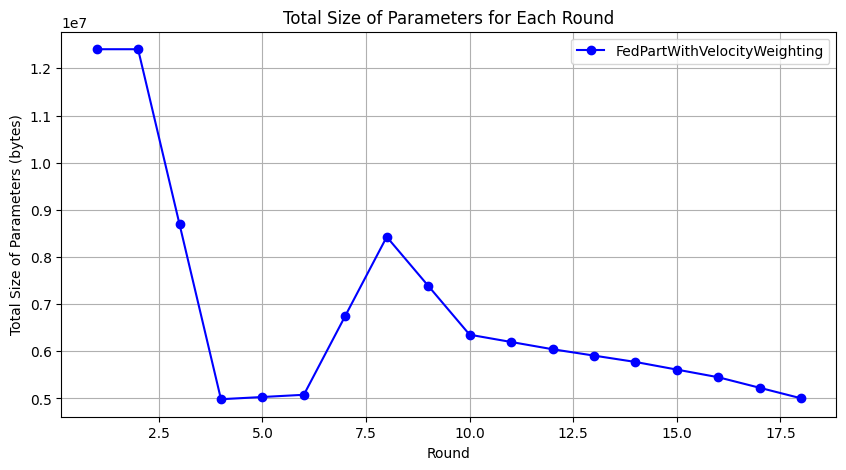

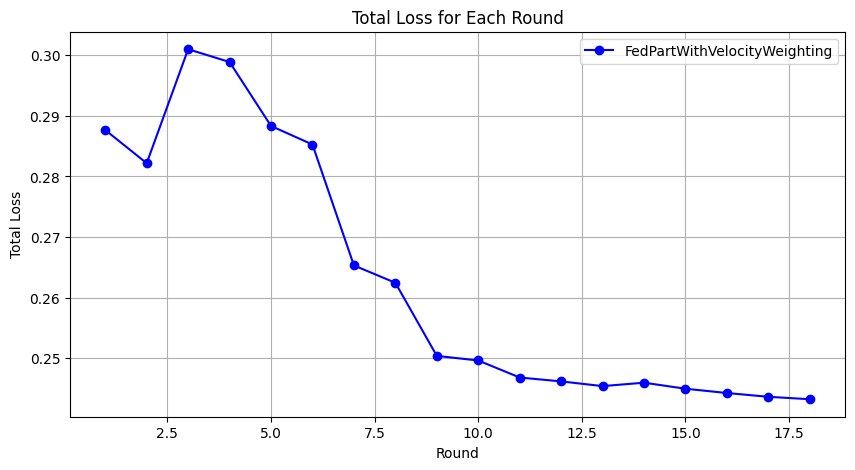

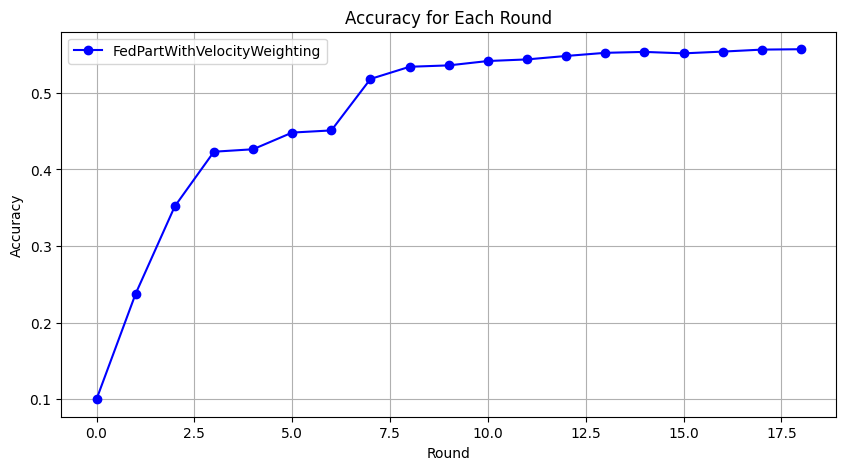

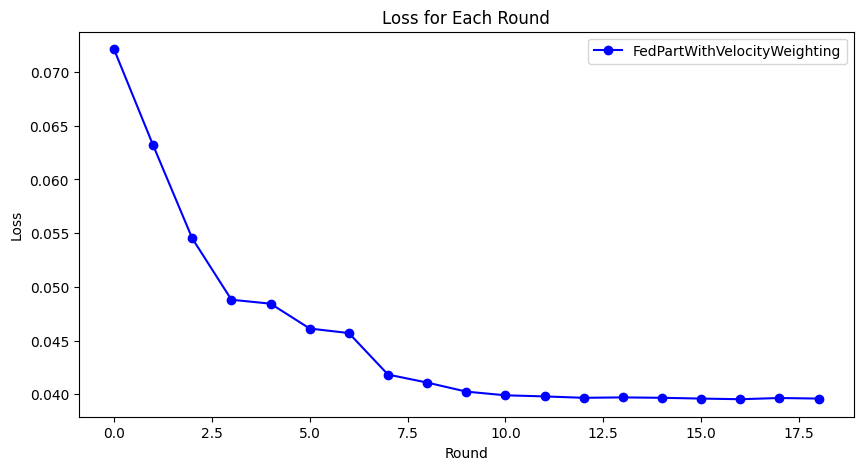

In [16]:
import matplotlib.pyplot as plt
import numpy as np

# Plot the total size of parameters for each round
fed_momentum_weighting_rounds = list(fed_momentum_weighting_results.keys())
fed_momentum_weighting_sizes = [fed_momentum_weighting_results[round]["total_size"] for round in fed_momentum_weighting_rounds]

plt.figure(figsize=(10, 5))
plt.plot(fed_momentum_weighting_rounds, fed_momentum_weighting_sizes, marker='o', linestyle='-', color='b', label='FedPartWithVelocityWeighting')
# plt.plot(fed_avg_rounds, fed_avg_sizes, marker='o', linestyle='-', color='r', label='FedAvg')
plt.xlabel('Round')
plt.ylabel('Total Size of Parameters (bytes)')
plt.title('Total Size of Parameters for Each Round')
plt.legend()
plt.grid(True)

fed_momentum_weighting_losses = [fed_momentum_weighting_results[round]["total_loss"] for round in fed_momentum_weighting_rounds]

plt.figure(figsize=(10, 5))
plt.plot(fed_momentum_weighting_rounds, fed_momentum_weighting_losses, marker='o', linestyle='-', color='b', label='FedPartWithVelocityWeighting')
# plt.plot(fed_avg_rounds, fed_avg_losses, marker='o', linestyle='-', color='r', label='FedAvg')
plt.xlabel('Round')
plt.ylabel('Total Loss')
plt.title('Total Loss for Each Round')
plt.legend()
plt.grid(True)


fed_momentum_weighting_model_rounds = list(fed_momentum_weighting_model_results.keys())
fed_momentum_weighting_accuracies = [fed_momentum_weighting_model_results[round]["global_metrics"]["accuracy"] for round in fed_momentum_weighting_model_rounds]

plt.figure(figsize=(10, 5))
plt.plot(fed_momentum_weighting_model_rounds, fed_momentum_weighting_accuracies, marker='o', linestyle='-', color='b', label='FedPartWithVelocityWeighting')
# plt.plot(fed_avg_model_rounds, fed_avg_accuracies, marker='o', linestyle='-', color='r', label='FedAvg')
plt.xlabel('Round')
plt.ylabel('Accuracy')
plt.title('Accuracy for Each Round')
plt.legend()
plt.grid(True)

fed_momentum_weighting_global_losses = [fed_momentum_weighting_model_results[round]["global_loss"] for round in fed_momentum_weighting_model_rounds]

plt.figure(figsize=(10, 5))
plt.plot(fed_momentum_weighting_model_rounds, fed_momentum_weighting_global_losses, marker='o', linestyle='-', color='b', label='FedPartWithVelocityWeighting')
# plt.plot(fed_avg_model_rounds, fed_avg_global_losses, marker='o', linestyle='-', color='r', label='FedAvg')
plt.xlabel('Round')
plt.ylabel('Loss')
plt.legend()
plt.title('Loss for Each Round')